## Importing the necessary libraries

In [1]:
!pip install pandas
!pip install numpy
!pip install matplotlib
!pip install scikit-learn
!pip install xgboost
!pip install keras
!pip install protobuf==3.20
!pip install tensorflow==2.7.0


  Using cached protobuf-3.20.0-cp39-cp39-win_amd64.whl (904 kB)
  Attempting uninstall: protobuf
    Found existing installation: protobuf 3.19.6
    Uninstalling protobuf-3.19.6:
      Successfully uninstalled protobuf-3.19.6


ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tensorboard 2.10.0 requires protobuf<3.20,>=3.9.2, but you have protobuf 3.20.0 which is incompatible.
mysql-connector-python 8.2.0 requires protobuf<=4.21.12,>=4.21.1, but you have protobuf 3.20.0 which is incompatible.


  Using cached protobuf-3.19.6-cp39-cp39-win_amd64.whl (895 kB)

ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
mysql-connector-python 8.2.0 requires protobuf<=4.21.12,>=4.21.1, but you have protobuf 3.19.6 which is incompatible.


  Attempting uninstall: protobuf
    Found existing installation: protobuf 3.20.0
    Uninstalling protobuf-3.20.0:
      Successfully uninstalled protobuf-3.20.0


In [2]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import PolynomialFeatures
from sklearn.decomposition import PCA
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score
os.environ['PROTOCOL_BUFFERS_PYTHON_IMPLEMENTATION'] = 'python'
from sklearn.ensemble import RandomForestRegressor
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import GridSearchCV
from sklearn.tree import DecisionTreeRegressor
import tensorflow as tf
import xgboost as xgb
from tensorflow import keras
from tensorflow.keras import layers
import keras
from keras.models import Sequential
from keras.callbacks import ModelCheckpoint
from keras.layers import Dense
from keras.wrappers.scikit_learn import KerasRegressor
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import KFold
from sklearn.pipeline import Pipeline
import pickle
import json
import requests
from sklearn.svm import SVR

### Importing the dataset using pandas library

In [3]:
data = pd.read_excel("fatigue_strength_data.xlsx")


C:\Users\ASUD\anaconda3\lib\site-packages\openpyxl\worksheet\_reader.py:312: UserWarning: Unknown extension is not supported and will be removed
  warn(msg)


In [4]:
data.shape

(437, 27)

In [5]:
data.head()

,Sl. No.,NT,THT,THt,THQCr,CT,Ct,DT,Dt,QmT,...,S,Ni,Cr,Cu,Mo,RedRatio,dA,dB,dC,Fatigue
0,1,885,30,0,0,30,0.0,30.0,0.0,30,...,0.022,0.01,0.02,0.01,0.0,825,0.07,0.02,0.04,232
1,2,885,30,0,0,30,0.0,30.0,0.0,30,...,0.017,0.08,0.12,0.08,0.0,610,0.11,0.00,0.04,235
2,3,885,30,0,0,30,0.0,30.0,0.0,30,...,0.015,0.02,0.03,0.01,0.0,1270,0.07,0.02,0.00,235
3,4,885,30,0,0,30,0.0,30.0,0.0,30,...,0.024,0.01,0.02,0.01,0.0,1740,0.06,0.00,0.00,241
4,5,885,30,0,0,30,0.0,30.0,0.0,30,...,0.022,0.01,0.02,0.02,0.0,825,0.04,0.02,0.00,225


In [6]:
data.columns=data.columns
print("Columns Name:", list(data.columns))

Columns Name: ['Sl. No.', 'NT', 'THT', 'THt', 'THQCr', 'CT', 'Ct', 'DT', 'Dt', 'QmT', 'TT', 'Tt', 'TCr', 'C', 'Si', 'Mn', 'P', 'S', 'Ni', 'Cr', 'Cu', 'Mo', 'RedRatio', 'dA', 'dB', 'dC', 'Fatigue']


In [12]:
for column in data.columns:
    unique_values = data[column].unique()
    num_unique_values = len(unique_values)
    print(f"{column} has {num_unique_values} unique value ")     # unique value(s): {unique_values}")


Sl. No. has 437 unique value 
NT has 7 unique value 
THT has 5 unique value 
THt has 2 unique value 
THQCr has 3 unique value 
CT has 2 unique value 
Ct has 12 unique value 
DT has 7 unique value 
Dt has 7 unique value 
QmT has 3 unique value 
TT has 13 unique value 
Tt has 3 unique value 
TCr has 3 unique value 
C has 42 unique value 
Si has 27 unique value 
Mn has 55 unique value 
P has 24 unique value 
S has 26 unique value 
Ni has 42 unique value 
Cr has 65 unique value 
Cu has 21 unique value 
Mo has 15 unique value 
RedRatio has 34 unique value 
dA has 21 unique value 
dB has 7 unique value 
dC has 10 unique value 
Fatigue has 250 unique value 


In [13]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 437 entries, 0 to 436
Data columns (total 27 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   Sl. No.   437 non-null    int64  
 1   NT        437 non-null    int64  
 2   THT       437 non-null    int64  
 3   THt       437 non-null    int64  
 4   THQCr     437 non-null    int64  
 5   CT        437 non-null    int64  
 6   Ct        437 non-null    float64
 7   DT        437 non-null    float64
 8   Dt        437 non-null    float64
 9   QmT       437 non-null    int64  
 10  TT        437 non-null    int64  
 11  Tt        437 non-null    int64  
 12  TCr       437 non-null    float64
 13  C         437 non-null    float64
 14  Si        437 non-null    float64
 15  Mn        437 non-null    float64
 16  P         437 non-null    float64
 17  S         437 non-null    float64
 18  Ni        437 non-null    float64
 19  Cr        437 non-null    float64
 20  Cu        437 non-null    float6

In [14]:
data.describe()


,Sl. No.,NT,THT,THt,THQCr,CT,Ct,DT,Dt,QmT,...,S,Ni,Cr,Cu,Mo,RedRatio,dA,dB,dC,Fatigue
count,437.000000,437.000000,437.000000,437.000000,437.000000,437.000000,437.000000,437.000000,437.000000,437.000000,...,437.000000,437.000000,437.000000,437.000000,437.000000,437.000000,437.000000,437.000000,437.000000,437.000000
mean,219.000000,872.299771,737.643021,25.949657,10.654462,128.855835,40.502059,123.699844,4.843936,35.491991,...,0.014611,0.517048,0.570458,0.067780,0.069794,923.629291,0.047181,0.003391,0.007712,552.903890
std,126.295289,26.212073,280.036541,10.263824,7.841437,281.743539,126.924697,267.128933,15.700076,19.419277,...,0.006145,0.852976,0.411769,0.049161,0.088124,576.617020,0.031093,0.008240,0.010418,186.630528
min,1.000000,825.000000,30.000000,0.000000,0.000000,30.000000,0.000000,30.000000,0.000000,30.000000,...,0.003000,0.010000,0.010000,0.010000,0.000000,240.000000,0.000000,0.000000,0.000000,225.000000
25%,110.000000,865.000000,845.000000,30.000000,8.000000,30.000000,0.000000,30.000000,0.000000,30.000000,...,0.010000,0.020000,0.120000,0.020000,0.000000,590.000000,0.020000,0.000000,0.000000,448.000000
50%,219.000000,870.000000,845.000000,30.000000,8.000000,30.000000,0.000000,30.000000,0.000000,30.000000,...,0.015000,0.060000,0.710000,0.060000,0.000000,740.000000,0.040000,0.000000,0.000000,505.000000
75%,328.000000,870.000000,855.000000,30.000000,8.000000,30.000000,0.000000,30.000000,0.000000,30.000000,...,0.019000,0.460000,0.980000,0.100000,0.170000,1228.000000,0.070000,0.000000,0.010000,578.000000
max,437.000000,930.000000,865.000000,30.000000,24.000000,930.000000,540.000000,903.333000,70.200000,140.000000,...,0.030000,2.780000,1.170000,0.260000,0.240000,5530.000000,0.130000,0.050000,0.058000,1190.000000


### Dropping the 'SI. No.' column

In [15]:
data.drop(['Sl. No.'],axis=1, inplace=True)

### Data correlation visualized using heat map

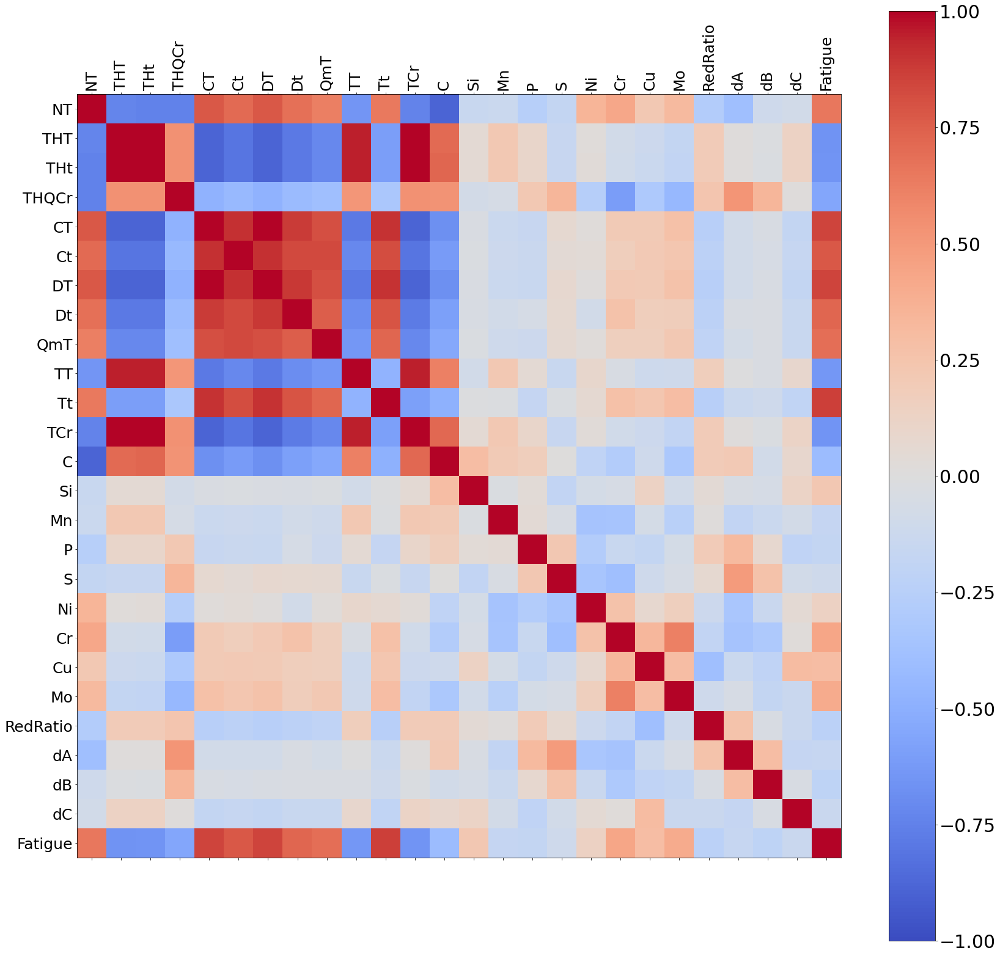

In [16]:
corr = data.corr()
fig = plt.figure(figsize=(28, 28))
ax = fig.add_subplot(111)
cax = ax.matshow(corr, cmap='coolwarm', vmin=-1, vmax=1)
cbar = fig.colorbar(cax)
cbar.ax.tick_params(labelsize=30)
ticks = np.arange(0, len(data.columns), 1)
ax.set_xticks(ticks)
ax.set_xticklabels(data.columns, fontsize=25)  
plt.xticks(rotation=90)
ax.set_yticks(ticks)
ax.set_yticklabels(data.columns, fontsize=25) 
plt.show()
fig.savefig('corr_heat_map.png')

### Splitting of the dataset into feature variable and target variable

In [45]:
feature = data.columns[:-1]
target = data.columns[-1]
X = data[feature]
y = data[target]

## Data Visualization

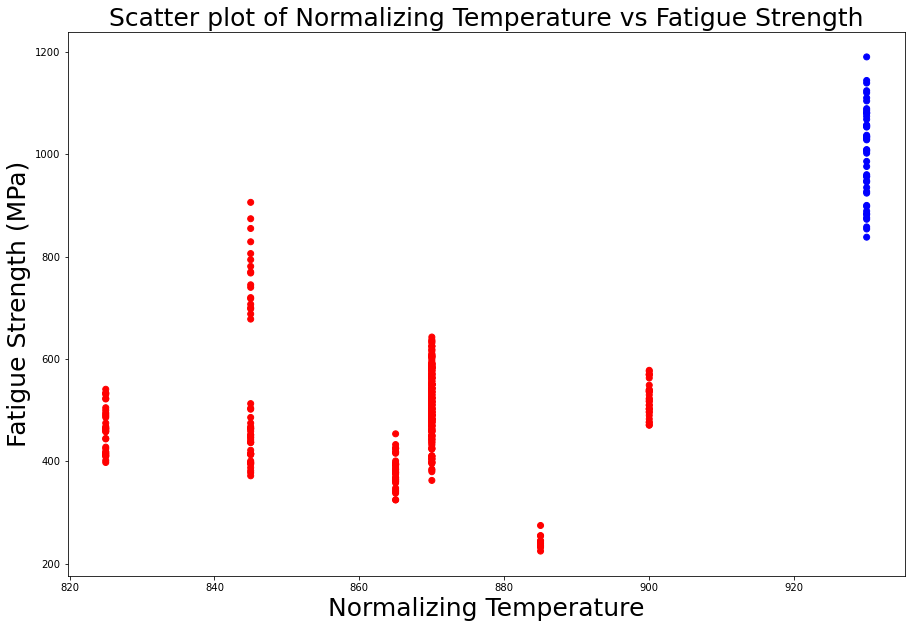

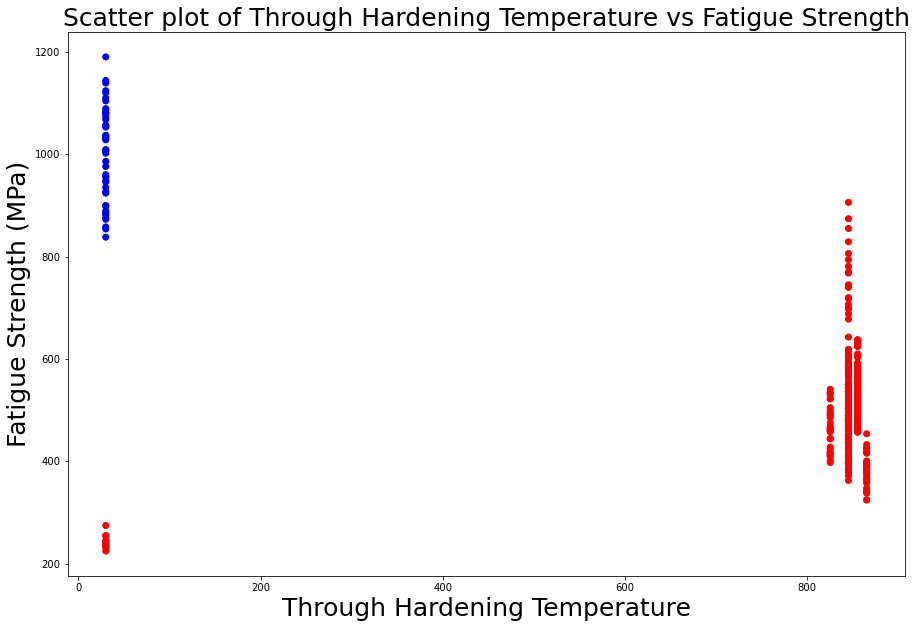

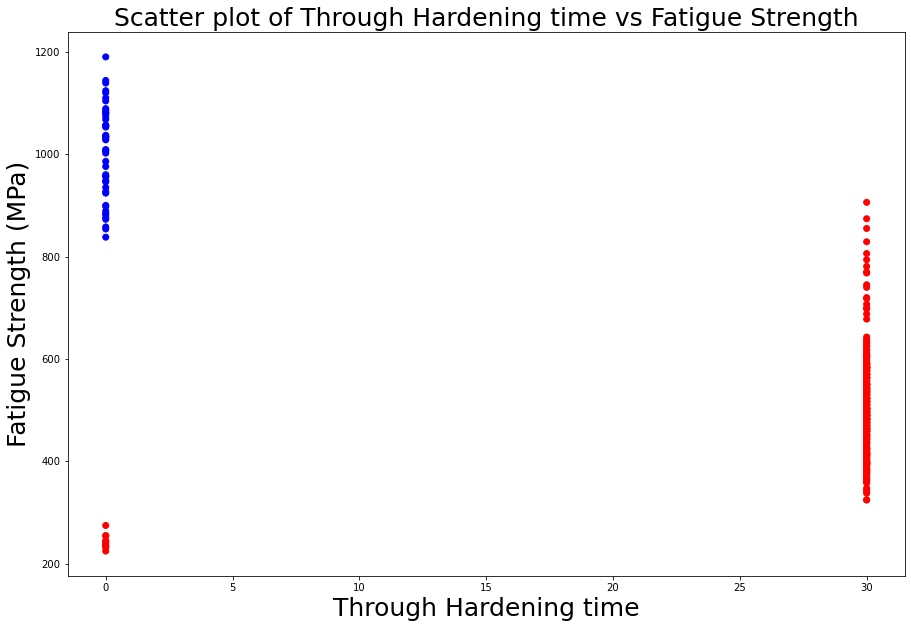

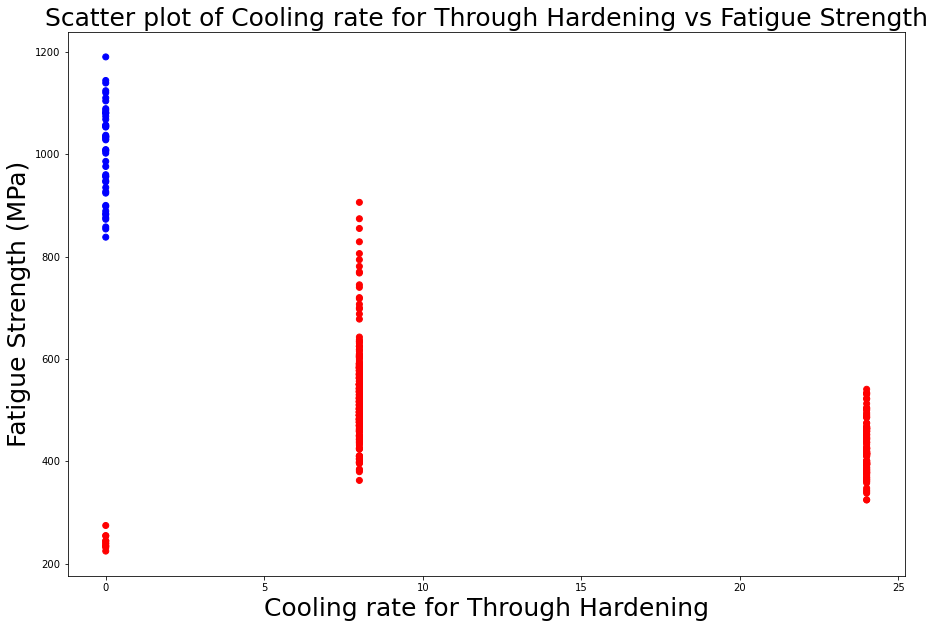

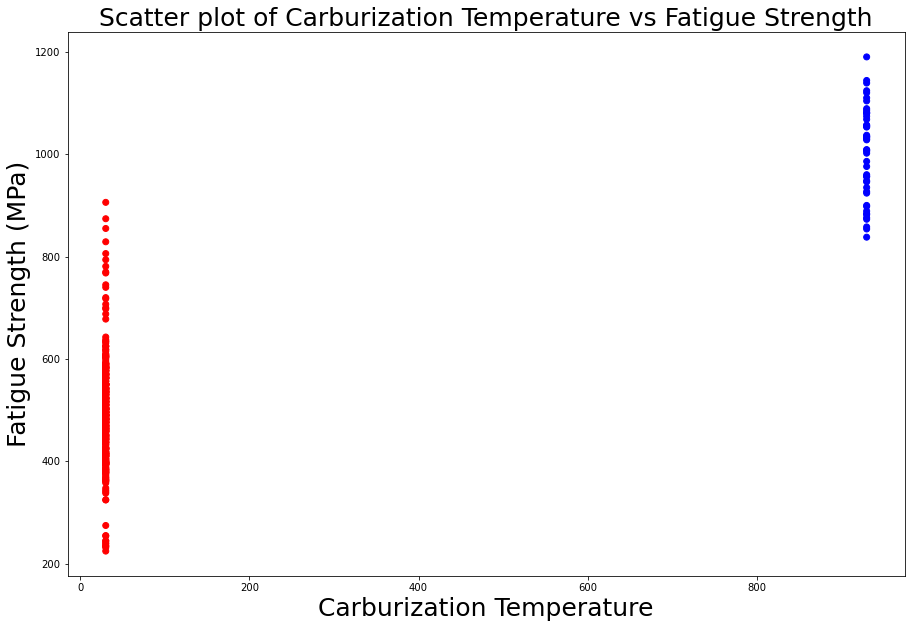

...

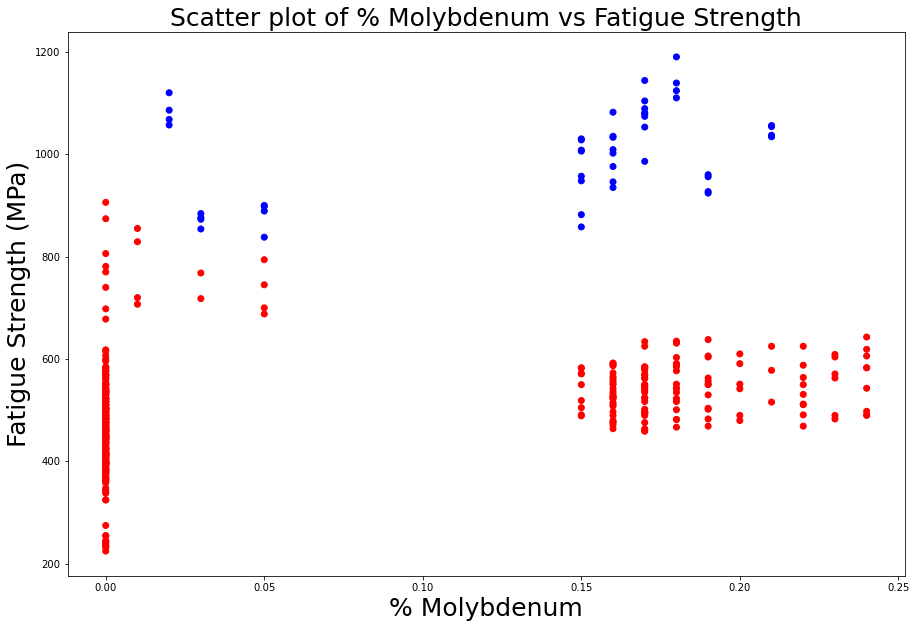

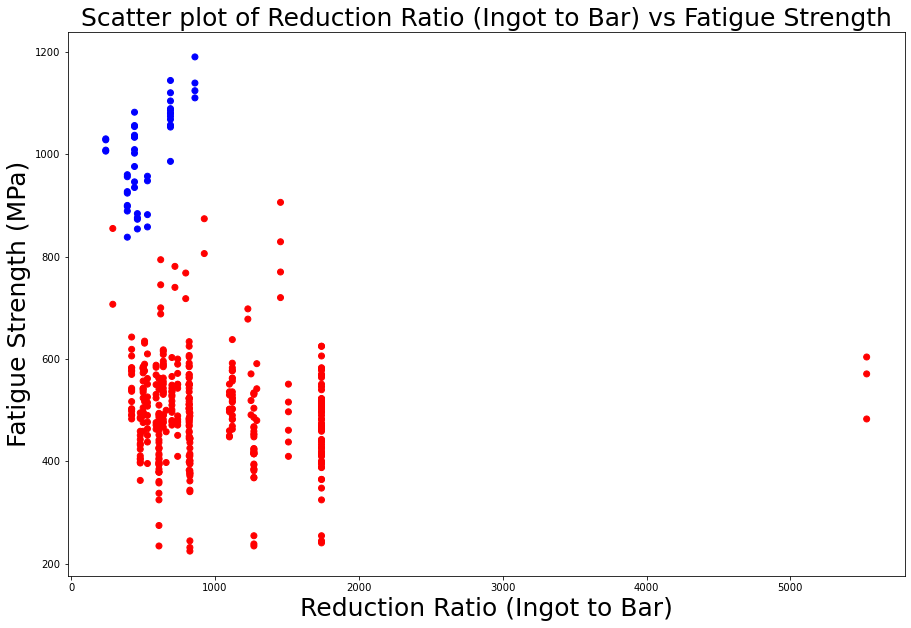

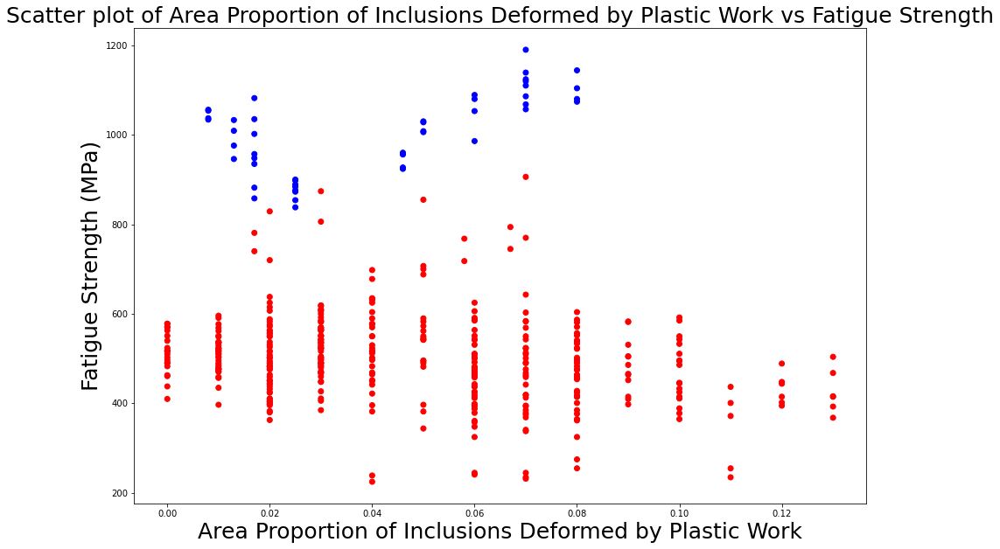

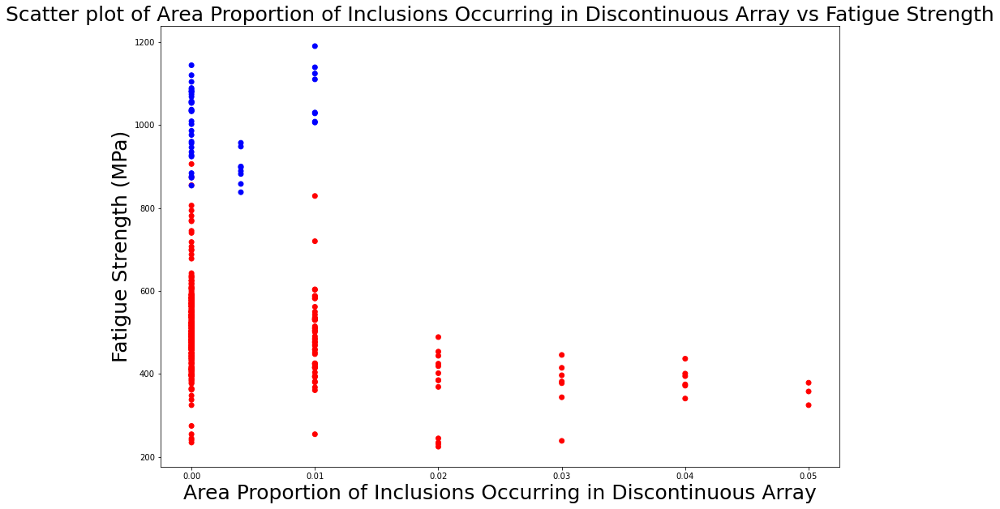

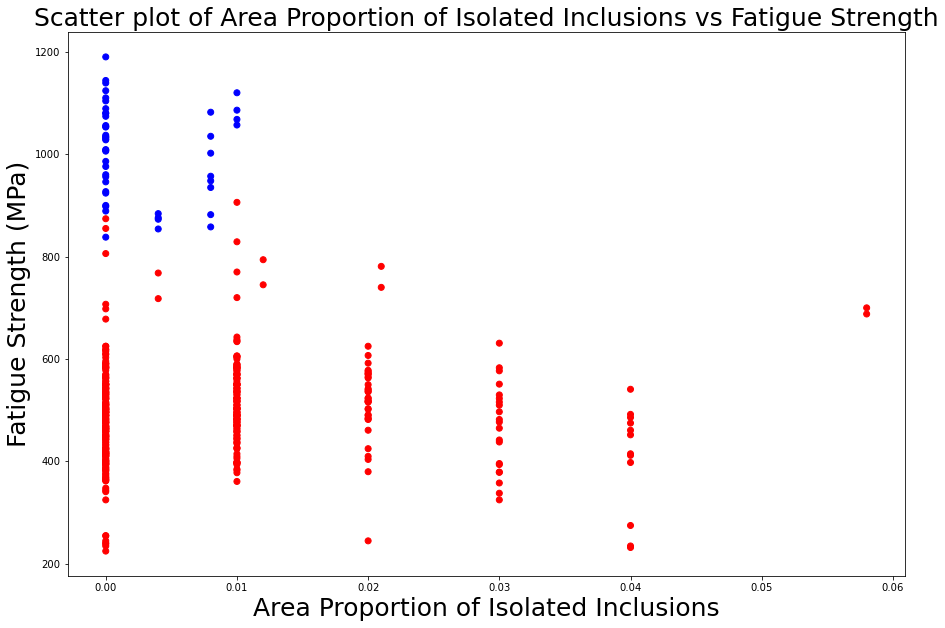

In [18]:
import matplotlib.pyplot as plt

# Define colors based on condition
label = data['CT']
color = ['red' if l == 30 else 'blue' for l in label]

# Get the column names except the last one
columns = ['NT', 'THT', 'THt', 'THQCr', 'CT', 'Ct', 'DT', 'Dt', 'QmT',
           'TT', 'Tt', 'TCr', 'C', 'Si', 'Mn', 'P', 'S', 'Ni', 'Cr', 'Cu', 'Mo',
           'RedRatio', 'dA', 'dB', 'dC']

# Abbreviation details for the columns
abbreviation_details = {
    'NT': 'Normalizing Temperature',
    'THT': 'Through Hardening Temperature',
    'THt': 'Through Hardening time',
    'THQCr': 'Cooling rate for Through Hardening',
    'CT': 'Carburization Temperature',
    'Ct': 'Carburization time',
    'DT': 'Diffusion Temperature',
    'Dt': 'Diffusion time',
    'QmT': 'Quenching media Temperature (for carburization)',
    'TT': 'Tempering Temperature',
    'Tt': 'Temperating time',
    'TCr': 'Cooling rate for Tempering',
    'C': '% Carbon',
    'Si': '% Silicon',
    'Mn': '% Manganese',
    'P': '% Phsophorous',
    'S': '% Sulphur',
    'Ni': '% Nickel',
    'Cr': '% Chromium',
    'Cu': '% Copper',
    'Mo': '% Molybdenum',
    'RedRatio': 'Reduction Ratio (Ingot to Bar)',
    'dA': 'Area Proportion of Inclusions Deformed by Plastic Work',
    'dB': 'Area Proportion of Inclusions Occurring in Discontinuous Array',
    'dC': 'Area Proportion of Isolated Inclusions'
}

# Plot each column against 'Fatigue'
for col in columns:
    plt.figure(figsize=(15, 10))
    plt.scatter(data[col], data['Fatigue'], color=color)
    plt.title(f'Scatter plot of {abbreviation_details[col]} vs Fatigue Strength', fontsize=25)
    plt.xlabel(abbreviation_details[col], fontsize=25)
    plt.ylabel('Fatigue Strength (MPa)', fontsize=25)
    plt.savefig(f'{col}_vs_FatigueStrength.png')
    plt.show()


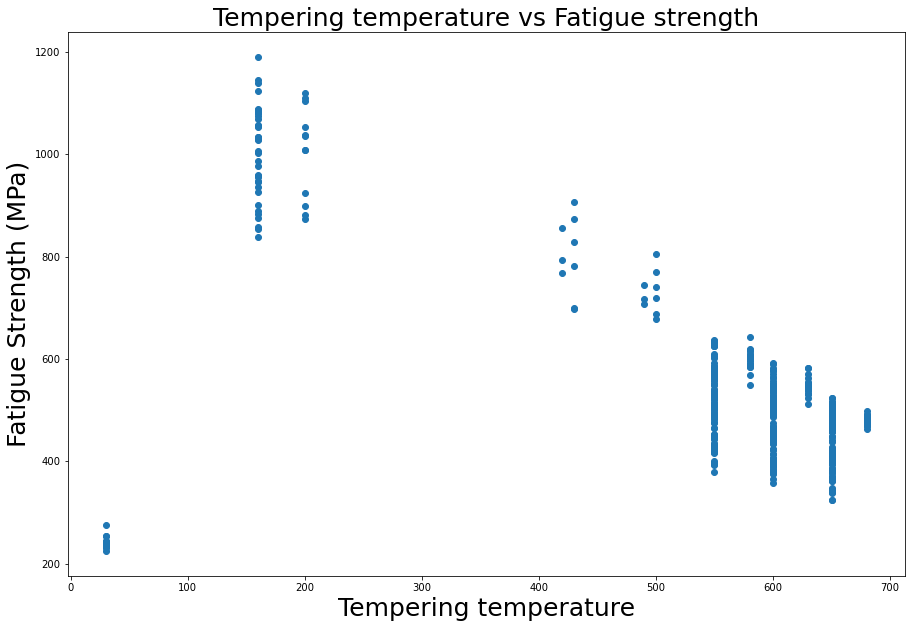

In [19]:
plt.scatter(data['TT'], data['Fatigue'])
fig = plt.gcf()
fig.set_size_inches(15, 10)
plt.title('Tempering temperature vs Fatigue strength',fontsize=25)
plt.xlabel('Tempering temperature',fontsize=25)
plt.ylabel('Fatigue Strength (MPa)',fontsize=25)
plt.savefig('TTvsFatigueStrength.png')

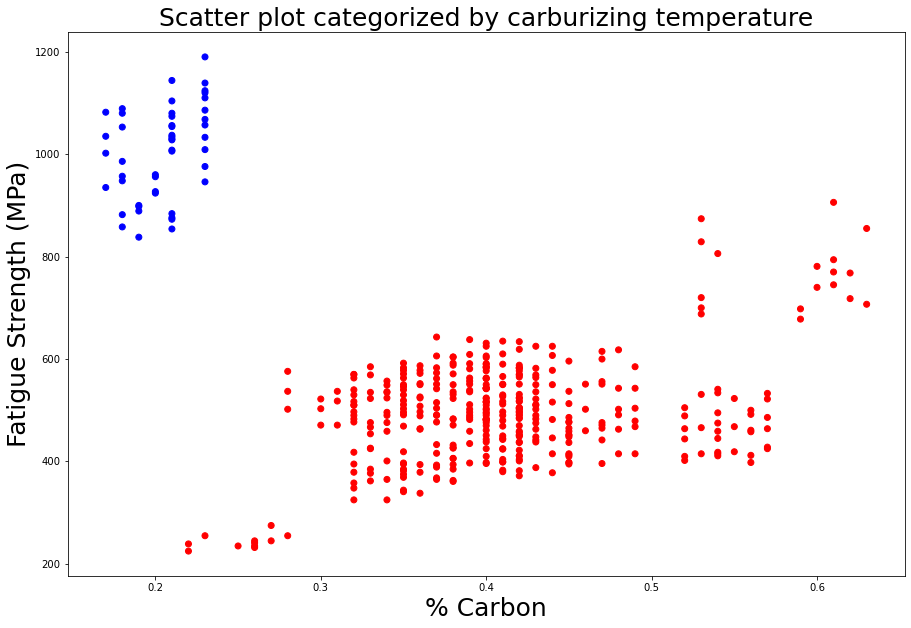

In [20]:
import matplotlib.pyplot as plt

# Define colors based on condition
label = data['CT']
color = ['red' if l == 30 else 'blue' for l in label]
# Create scatter plot
plt.figure(figsize=(15, 10))
plt.scatter(data['C'], data['Fatigue'], color=color)
plt.title('Scatter plot categorized by carburizing temperature',fontsize=25)
plt.xlabel('% Carbon',fontsize=25)
plt.ylabel('Fatigue Strength (MPa)',fontsize=25)
plt.savefig('CarbonvsFatigueStrength.png')
plt.show()


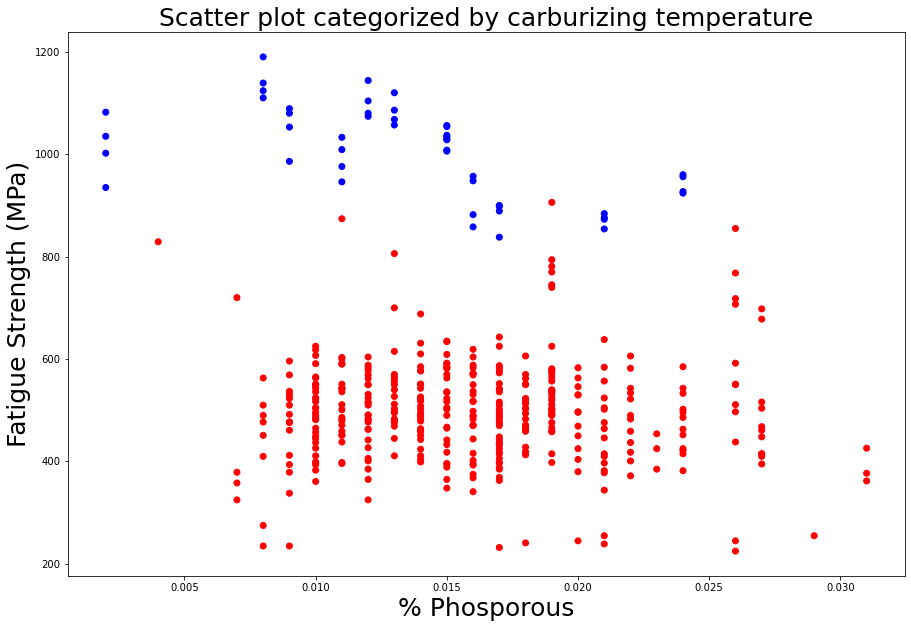

In [21]:
label = data['CT']
color = ['red' if l == 30 else 'blue' for l in label]
fig = plt.gcf()
fig.set_size_inches(15, 10)
plt.scatter(data['P'], data['Fatigue'], color = color)
plt.title('Scatter plot categorized by carburizing temperature',fontsize=25)
plt.xlabel('% Phosporous',fontsize=25)
plt.ylabel('Fatigue Strength (MPa)',fontsize=25)
plt.savefig('PhosporousvsFatigueStrength.png')

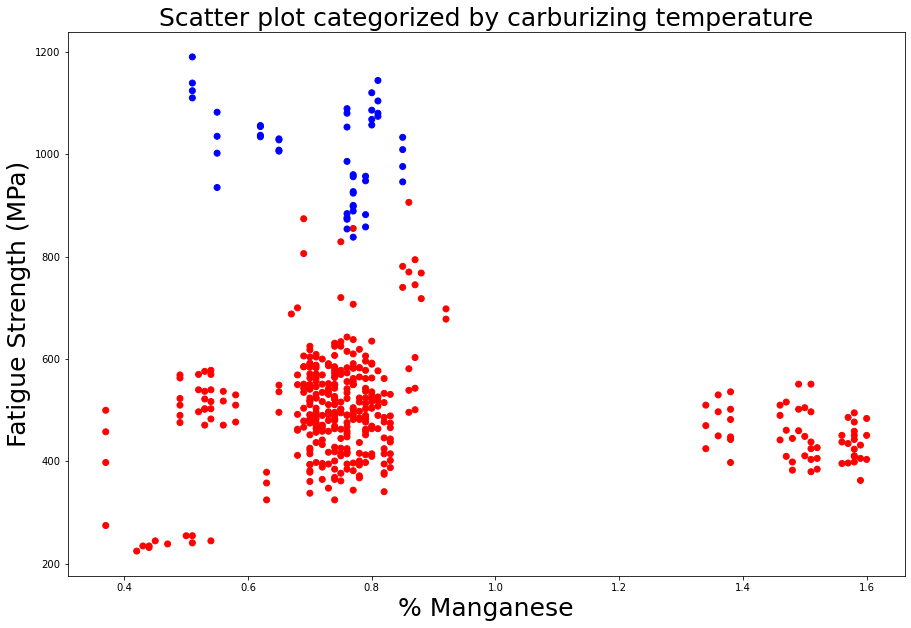

In [22]:
label = data['CT']
color = ['red' if l == 30 else 'blue' for l in label]
fig = plt.gcf()
fig.set_size_inches(15, 10)
plt.scatter(data['Mn'], data['Fatigue'], color = color)
plt.title('Scatter plot categorized by carburizing temperature',fontsize=25)
plt.xlabel('% Manganese',fontsize=25)
plt.ylabel('Fatigue Strength (MPa)',fontsize=25)
plt.savefig('ManganesevsFatigueStrength.png')

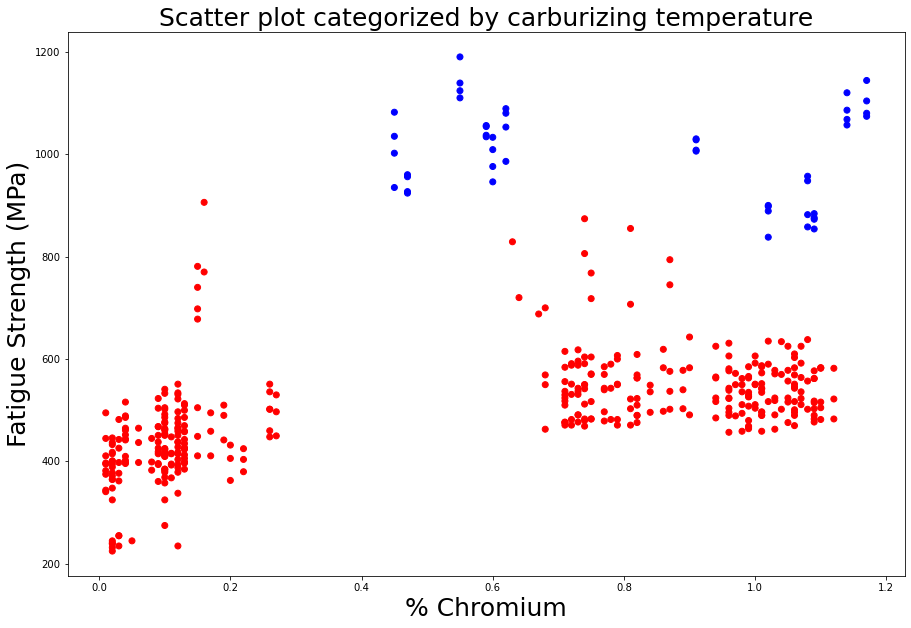

In [23]:
label = data['CT']
color = ['red' if l == 30 else 'blue' for l in label]
fig = plt.gcf()
fig.set_size_inches(15, 10)
plt.scatter(data['Cr'], data['Fatigue'], color = color)
plt.title('Scatter plot categorized by carburizing temperature',fontsize=25)
plt.xlabel('% Chromium',fontsize=25)
plt.ylabel('Fatigue Strength (MPa)',fontsize=25)
plt.savefig('ChromiumvsFatigueStrength.png')

In [156]:
import pandas_profiling as pp
profile_report = pp.ProfileReport(data)
profile_report


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## Feature Ranking

### 1. Univariate Selection

 Univariate analysis examines the relationship of each feature with the target variable individually. This can be measured using Pearson coefficient, Maximal Information Coefficient or distance correlation.

#### 1.Pearson Coefficient: 
It is a measure of the correlation between two variables. It has a value between -1 and +1 with -1 being perfect negative correlation and +1 being perfect positive correlation. Pearson correlation of 0 does not mean the variables are independent.
                        ρ(x,y) = cov(X,Y)/σxσy

#### 2. Maximal Information Coefficient:
It measures the mutual dependance between two variables. MIC gives a score in bits which is not normalized. It is also inconvenient to compute it for continuous variables  in general the variables need to be discretized by binning, but the mutual information score can be quite sensitive to bin selection.

                              I(X,Y) = ∑∑p(x,y)log[p(x,y)/p(x)p(y)]
    
 #### 3. Distance correlation:
 It is a measure of dependence between two paired random vectors of arbitrary, not necessarily equal, dimension. Thus, distance correlation measures both linear and nonlinear association between two random variables or random vectors.

In [46]:
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import chi2

In [47]:
test = SelectKBest(score_func=chi2, k=4)
fit = test.fit(X, y)
np.set_printoptions(precision=3)
print(fit.scores_/sum(fit.scores_))

[3.389e-04 5.291e-02 2.021e-03 2.438e-03 3.067e-01 1.976e-01 2.872e-01
 2.526e-02 5.290e-03 2.455e-02 3.529e-03 1.559e-03 1.017e-05 9.978e-05
 3.028e-05 5.358e-07 8.366e-07 4.007e-04 1.230e-04 1.184e-05 3.851e-05
 8.978e-02 6.259e-06 6.809e-06 4.158e-06]


In [48]:
# Selected Features:
features = fit.transform(X)
print(features[0:5,:])

[[  30.    0.   30.  825.]
 [  30.    0.   30.  610.]
 [  30.    0.   30. 1270.]
 [  30.    0.   30. 1740.]
 [  30.    0.   30.  825.]]


### 2. Recursive Feature Elimination

Given an external estimator that assigns weights to features, the goal of recursive feature elimination (RFE) is to select features by recursively considering smaller and smaller sets of features. First, the estimator is trained on the initial set of features and the importance of each feature is obtained. Then, the least important features are pruned from current set of features. That procedure is recursively repeated on the pruned set until the desired number of features to select is eventually reached

In [49]:
sc = StandardScaler()
X = sc.fit_transform(X)

In [50]:
from sklearn.feature_selection import RFE
from sklearn.linear_model import LogisticRegression

# Create a logistic regression model
model = LogisticRegression(max_iter=1000)

# Specify the number of features to select
n_features_to_select = 10

# Create the RFE object with the specified model and number of features
rfe = RFE(estimator=model, n_features_to_select=n_features_to_select)

# Fit the RFE object to the data
fit = rfe.fit(X, y)

# Print the results
print("Num Features: %d" % fit.n_features_)
print("Selected Features: %s" % fit.support_)
print("Feature Ranking: %s" % fit.ranking_)


Num Features: 10
Selected Features: [False False False False False False False False False  True False False
  True False False  True  True False  True  True  True  True  True False
  True]
Feature Ranking: [ 7 11 14  5 15  6 16 10  8  1 12 13  1  9  4  1  1  2  1  1  1  1  1  3
  1]


## Principal Component Analysis

Principal component analysis (PCA) is a statistical procedure that uses an orthogonal transformation to convert a set of observations of possibly correlated variables into a set of values of linearly uncorrelated variables called principal components. This transformation is defined in such a way that the first principal component has the largest possible variance, and each succeeding component in turn has the highest variance possible under the constraint that it is orthogonal to the preceding components. The resulting vectors are an uncorrelated orthogonal basis set. PCA is sensitive to the relative scaling of the original variables.

In [51]:
pca = PCA(n_components=2, random_state=1)
principal_components = pca.fit_transform(X)

In [54]:
principal_components=np.array(principal_components)

In [58]:
principal_components.shape

(437, 2)

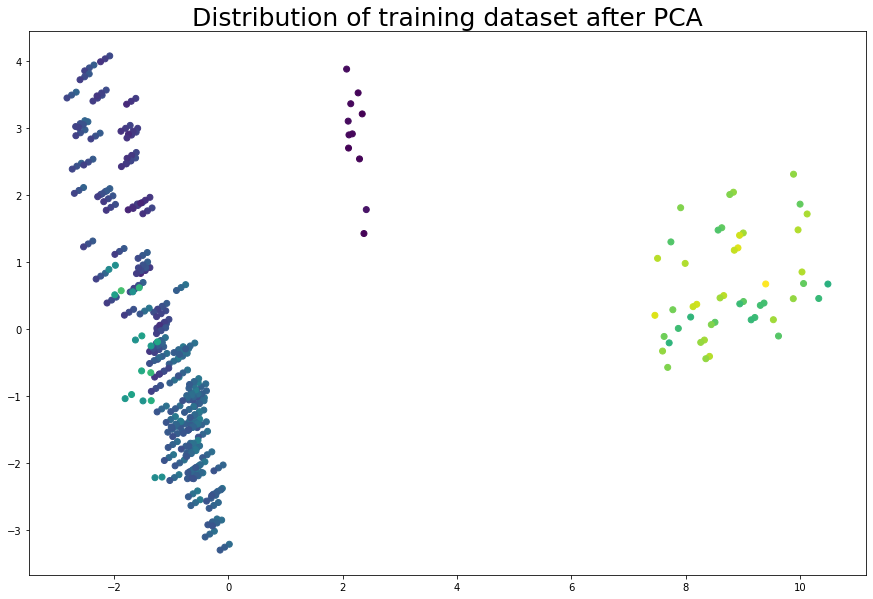

In [59]:
plt.scatter(principal_components[:,0],principal_components[:,1], c = y)
plt.title("Distribution of training dataset after PCA",fontsize=25)
fig = plt.gcf()
fig.set_size_inches(15, 10)
plt.savefig('pca.png')

In [60]:
sc = StandardScaler()
X = sc.fit_transform(X)

In [61]:
X.shape

(437, 25)

In [62]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)

## SVM regressor

Support Vector Machine can also be used as a regression method, maintaining all the main features that characterize the algorithm (maximal margin). The Support Vector Regression (SVR) uses the same principles as the SVM for classification, with only a few minor differences. First of all, because output is a real number it becomes very difficult to predict the information at hand, which has infinite possibilities. In the case of regression, a margin of tolerance (epsilon) is set in approximation to the SVM which would have already requested from the problem. The main idea is the same: to minimize error, individualizing the hyperplane which maximizes the margin, keeping in mind that part of the error is tolerated.

Hyperplane is the line that will help us predict the continuous value or target value. There are two lines other than Hyper Plane which creates a margin. These are the boundary lines. Support vectors can be on the Boundary lines or outside it. 

In [63]:
from sklearn.svm import SVR
svreg = SVR(kernel='linear', verbose=1, C=15)
svreg.fit(X_train, y_train)
SVRtrain_r2 = r2_score(y_train, svreg.predict(X_train))
print("\n r2_score for SVM Regressor on Train data:", SVRtrain_r2)

[LibSVM]
 r2_score for SVM Regressor on Train data: 0.9648315352686074


In [64]:
Y_pred_3 = svreg.predict(X_test)
SVRtest_r2 = r2_score(y_test, Y_pred_3)
print("r2_score forSVM Regressor Test data:", SVRtest_r2)

r2_score forSVM Regressor Test data: 0.9562091423070121


### Visualizing the predictions made by the SVM Regressor algorithm and comparing it with the actual data points present in the training and testing dataset.

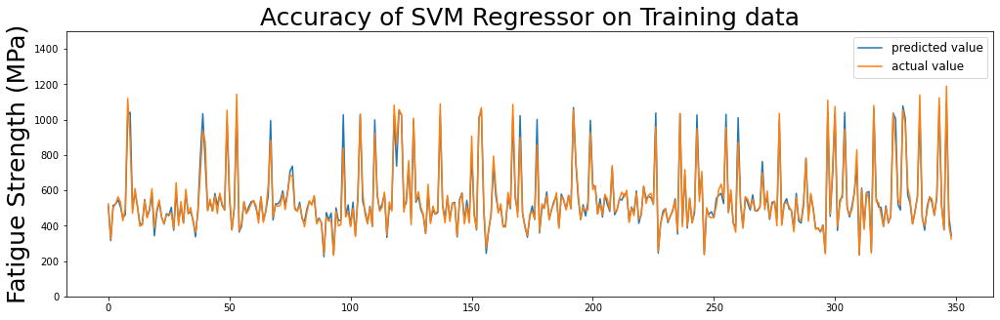

In [65]:
train_pred_3 = svreg.predict(X_train)
plt.plot(range(349), train_pred_3)
plt.plot(range(349), y_train)
plt.ylim(0, 1500)
plt.ylabel('Fatigue Strength (MPa)',fontsize=25)
L = plt.legend('upper right', prop={'size': 12})
L.get_texts()[0].set_text('predicted value')
L.get_texts()[1].set_text('actual value')
fig = plt.gcf()
fig.set_size_inches(17, 5)
plt.title('Accuracy of SVM Regressor on Training data',fontsize=25)
plt.savefig('SVMRegressorTrain.png')

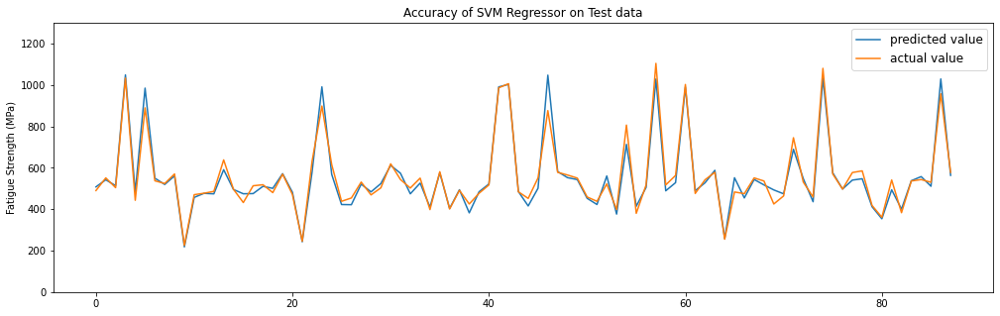

In [66]:
plt.plot(range(88), Y_pred_3)
plt.plot(range(88), y_test)
plt.ylim(0, 1300)
plt.ylabel('Fatigue Strength (MPa)')
L = plt.legend('upper right', prop={'size': 12})
L.get_texts()[0].set_text('predicted value')
L.get_texts()[1].set_text('actual value')
fig = plt.gcf()
fig.set_size_inches(17, 5)
plt.title('Accuracy of SVM Regressor on Test data')
plt.savefig('SVMRegressorTest.png')
plt.show()

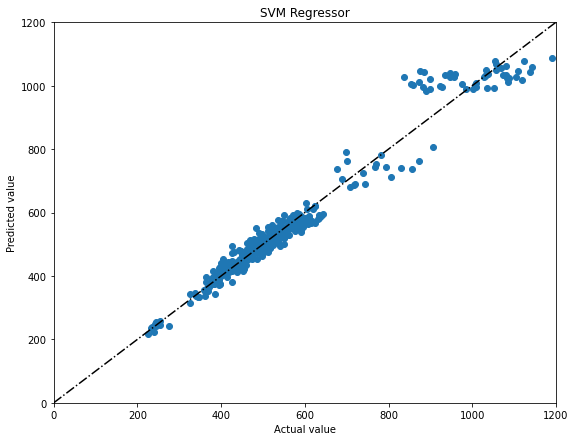

In [67]:
x = np.linspace(0, 1200, 1000)
plt.plot(x, x+0, '-.k')
plt.scatter(y, svreg.predict(X))
plt.title("SVM Regressor")
plt.xlabel("Actual value")
plt.ylabel("Predicted value")
fig = plt.gcf()
fig.set_size_inches(9, 7)
plt.xlim(0,1200)
plt.ylim(0,1200)
plt.savefig('SVMRegressorScatter.png')

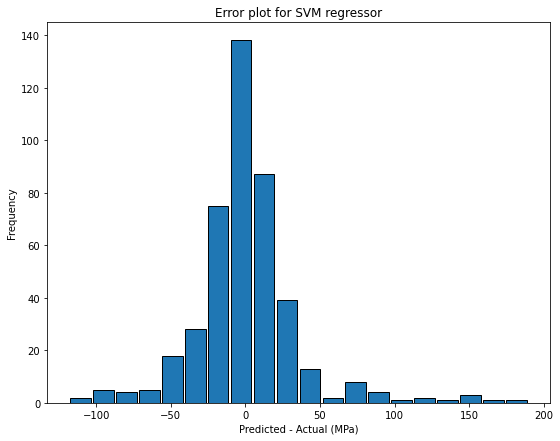

In [68]:
error = svreg.predict(X) - y
plt.hist(error, edgecolor='black', linewidth = 1.0, rwidth = 0.9, bins=20)
plt.title("Error plot for SVM regressor")
plt.xlabel("Predicted - Actual (MPa)")
plt.ylabel("Frequency")
fig = plt.gcf()
fig.set_size_inches(9, 7)
plt.savefig('SVMRegressorError.png')

## Linear Regression

    Simple linear regression is useful for finding relationship between two continuous variables. One is predictor or independent variable and other is response or dependent variable. It looks for statistical relationship but not deterministic relationship. Relationship between two variables is said to be deterministic if one variable can be accurately expressed by the other. Statistical relationship is not accurate in determining relationship between two variables.

    The core idea is to obtain a line that best fits the data. The best fit line is the one for which total prediction error (all data points) are as small as possible. Error is the distance between the point to the regression line.

In [69]:
linreg = LinearRegression().fit(X_train,y_train)
linregression = linreg.score(X,y)
LTerror = r2_score(y_train, linreg.predict(X_train))
print("Linear Regression Training data:", LTerror)

Linear Regression Training data: 0.9726031000897364


In [70]:
Y_pred_1 = linreg.predict(X_test)
linerror = r2_score(y_test, Y_pred_1)
print("Linear Regression Test data:", linerror)

Linear Regression Test data: 0.9660394534915431


### Visualizing the predictions made by the Linear regression algorithm and comparing it with the actual data points present in the training and testing dataset.

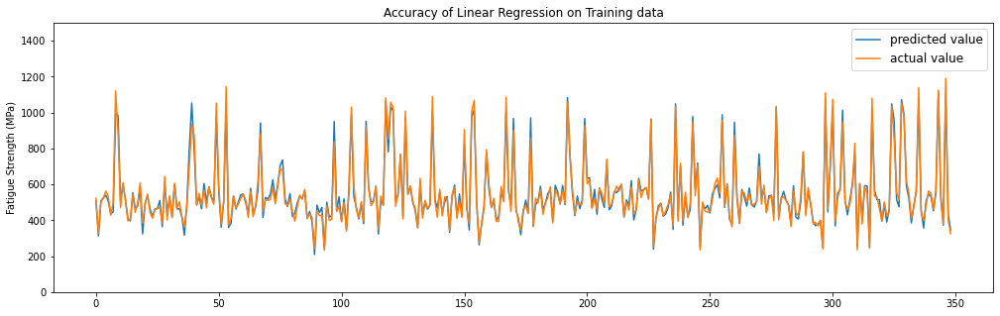

In [71]:
train_pred_1 = linreg.predict(X_train)
plt.plot(range(349), train_pred_1)
plt.plot(range(349), y_train)
plt.ylim(0, 1500)
plt.ylabel('Fatigue Strength (MPa)')
L = plt.legend('upper right', prop={'size': 12})
L.get_texts()[0].set_text('predicted value')
L.get_texts()[1].set_text('actual value')
fig = plt.gcf()
fig.set_size_inches(17, 5)
plt.title('Accuracy of Linear Regression on Training data')
plt.savefig('LinRegTrain.png')

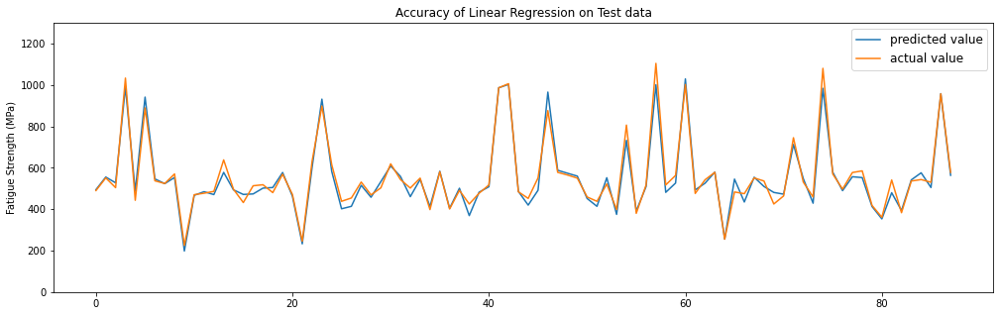

In [72]:
plt.plot(range(88), Y_pred_1)
plt.plot(range(88), y_test)
plt.ylim(0, 1300)
plt.ylabel('Fatigue Strength (MPa)')
L = plt.legend('upper right', prop={'size': 12})
L.get_texts()[0].set_text('predicted value')
L.get_texts()[1].set_text('actual value')
fig = plt.gcf()
fig.set_size_inches(17, 5)
plt.title('Accuracy of Linear Regression on Test data')
plt.savefig('LinRegTest.png')
plt.show()

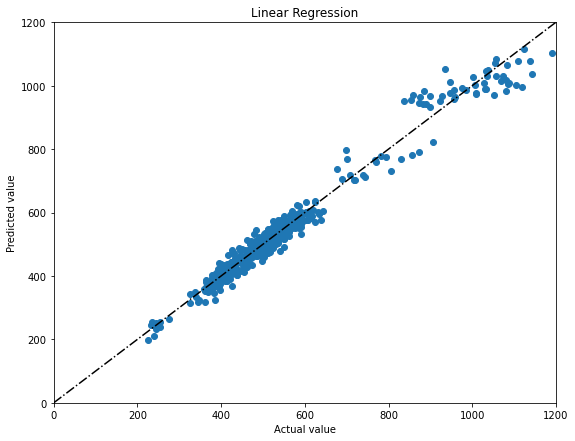

In [73]:
x = np.linspace(0, 1200, 1000)
plt.plot(x, x+0, '-.k')
plt.scatter(y, linreg.predict(X))
plt.title("Linear Regression")
plt.xlabel("Actual value")
plt.ylabel("Predicted value")
fig = plt.gcf()
fig.set_size_inches(9, 7)
plt.xlim(0,1200)
plt.ylim(0,1200)
plt.savefig('LinRegScatter.png')

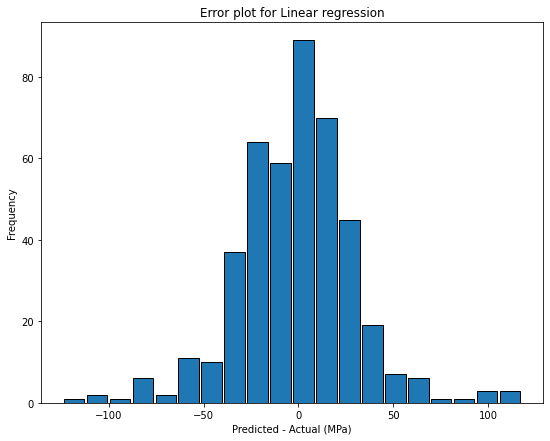

In [74]:
error_1 = linreg.predict(X) - y
plt.hist(error_1, edgecolor='black', linewidth = 1.0, rwidth = 0.9, bins=20)
plt.title("Error plot for Linear regression")
plt.xlabel("Predicted - Actual (MPa)")
plt.ylabel("Frequency")
fig = plt.gcf()
fig.set_size_inches(9, 7)
plt.savefig('LinRegError.png')

## Polynomial regression

 Polynomial Regression is a form of linear regression in which the relationship between the independent variable x and dependent variable y is modeled as an nth degree polynomial. Polynomial regression fits a nonlinear relationship between the value of x and the corresponding conditional mean of y, denoted E(y|x)
    
 Polynomial Regression are basically used to define or describe non-linear phenomenon such as growth rate of tissues, progression of disease epidemics and distribution of carbon isotopes in lake sediments

In [75]:
poly = PolynomialFeatures(degree =2) 
X_poly = poly.fit_transform(X) 
  
poly.fit(X_poly, y)

PolynomialFeatures()

In [76]:
X_train_poly = poly.fit_transform(X_train)
polreg = LinearRegression().fit(X_train_poly,y_train)
PTerror = r2_score(y_train, polreg.predict(X_train_poly))
print("Polynomial Regression Training data:", LTerror)

Polynomial Regression Training data: 0.9726031000897364


In [78]:
X_test_poly = poly.fit_transform(X_test)
Y_pred_16 = polreg.predict(X_test_poly)
polerror = r2_score(y_test, Y_pred_16)
print("Polynomial Regression Test data:", linerror)

Polynomial Regression Test data: 0.9660394534915431


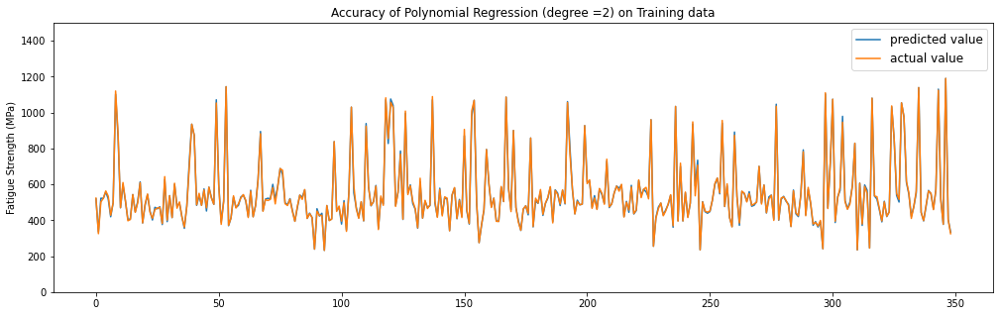

In [79]:
train_pred_11 = polreg.predict(X_train_poly)
plt.plot(range(349), train_pred_11)
plt.plot(range(349), y_train)
plt.ylim(0, 1500)
plt.ylabel('Fatigue Strength (MPa)')
L = plt.legend('upper right', prop={'size': 12})
L.get_texts()[0].set_text('predicted value')
L.get_texts()[1].set_text('actual value')
fig = plt.gcf()
fig.set_size_inches(17, 5)
plt.title('Accuracy of Polynomial Regression (degree =2) on Training data')
plt.savefig('PolRegTrain.png')

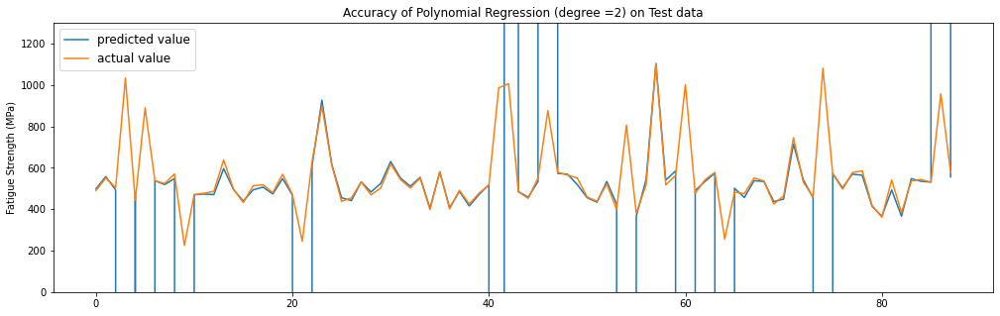

In [80]:
plt.plot(range(88), Y_pred_16)
plt.plot(range(88), y_test)
plt.ylim(0, 1300)
plt.ylabel('Fatigue Strength (MPa)')
L = plt.legend('upper right', prop={'size': 12})
L.get_texts()[0].set_text('predicted value')
L.get_texts()[1].set_text('actual value')
fig = plt.gcf()
fig.set_size_inches(17, 5)
plt.title('Accuracy of Polynomial Regression (degree =2) on Test data')
plt.savefig('PolRegTest.png')
plt.show()

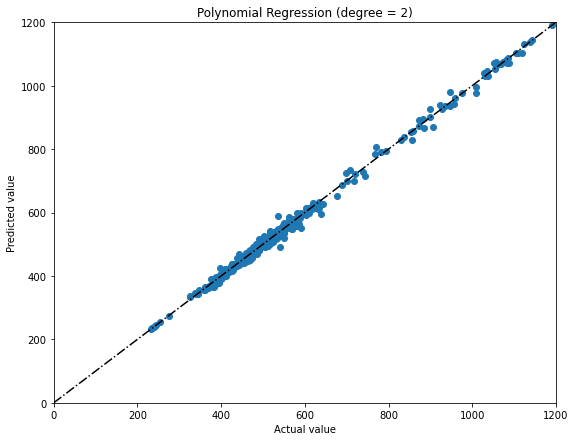

In [81]:
x = np.linspace(0, 1200, 1000)
plt.plot(x, x+0, '-.k')
plt.scatter(y, polreg.predict(X_poly))
plt.title("Polynomial Regression (degree = 2)")
plt.xlabel("Actual value")
plt.ylabel("Predicted value")
fig = plt.gcf()
fig.set_size_inches(9, 7)
plt.xlim(0,1200)
plt.ylim(0,1200)
plt.savefig('PolRegScatter.png')

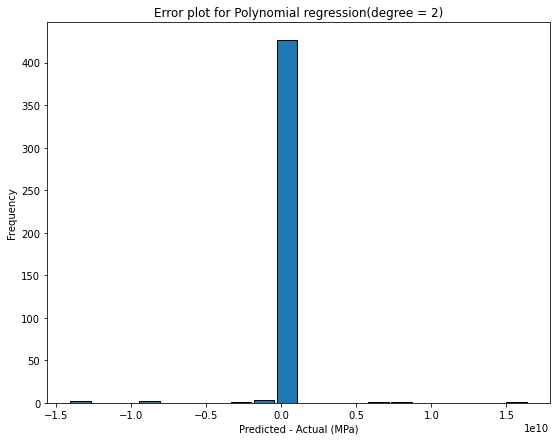

In [82]:
error_1 = polreg.predict(X_poly) - y
plt.hist(error_1, edgecolor='black', linewidth = 1.0, rwidth = 0.9, bins=20)
plt.title("Error plot for Polynomial regression(degree = 2)")
plt.xlabel("Predicted - Actual (MPa)")
plt.ylabel("Frequency")
fig = plt.gcf()
fig.set_size_inches(9, 7)
plt.savefig('PolRegError.png')

## Decision Tree Regressor

Decision Trees are a non-parametric supervised learning method used for classification and regression. The goal is to create a model that predicts the value of a target variable by learning simple decision rules inferred from the data features. Decision Trees are Simple to understand and to interpret They require very little data preparation.  Thus it can be classified as a white box model i.e., if a given situation is observable in a model, the explanation for the condition is easily explained by boolean logic.

A Decision tree regreesor breaks down the dataset into smaller and smaller subsets while at the same time an associated decision tree is incrementally developed. The final result is a tree with decision nodes and leaf nodes. A decision node (e.g., Outlook) has two or more branches (e.g., Sunny, Overcast and Rainy), each representing values for the attribute tested. Leaf node (e.g., Hours Played) represents a decision on the numerical target. The topmost decision node in a tree which corresponds to the best predictor called root node. Decision trees can handle both categorical and numerical data. 

In [83]:
dtregr = DecisionTreeRegressor(max_depth=7, random_state=1)
dtregr.fit(X_train, y_train)
DTRtrain = r2_score(y_train, dtregr.predict(X_train))
print("Decision Tree Train data:", DTRtrain)

Decision Tree Train data: 0.992247132396906


In [84]:
Y_pred_4 = dtregr.predict(X_test)
DTRerror = r2_score(y_test, Y_pred_4)
print("Decision Tree Test data:", DTRerror)

Decision Tree Test data: 0.9665272331050199


### Visualizing the predictions made by the Decision Tree Regressor and comparing it with the actual data points present in the training and testing dataset.

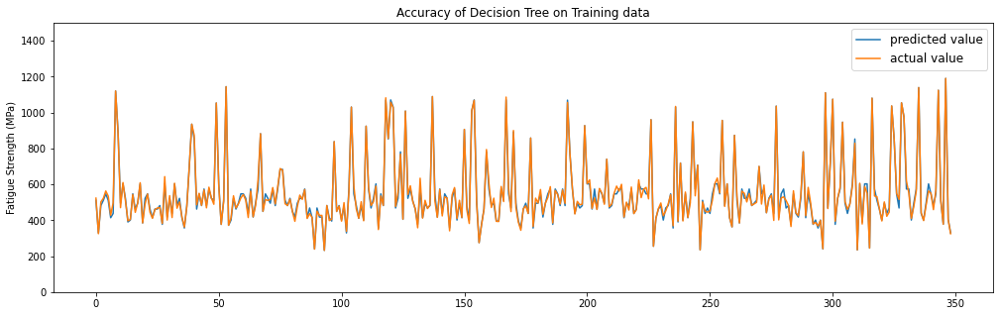

In [85]:
train_pred_4 = dtregr.predict(X_train)
plt.plot(range(349), train_pred_4)
plt.plot(range(349), y_train)
plt.ylim(0, 1500)
plt.ylabel('Fatigue Strength (MPa)')
L = plt.legend('upper right', prop={'size': 12})
L.get_texts()[0].set_text('predicted value')
L.get_texts()[1].set_text('actual value')
fig = plt.gcf()
fig.set_size_inches(17, 5)
plt.title('Accuracy of Decision Tree on Training data')
plt.savefig('DTTrain.png')

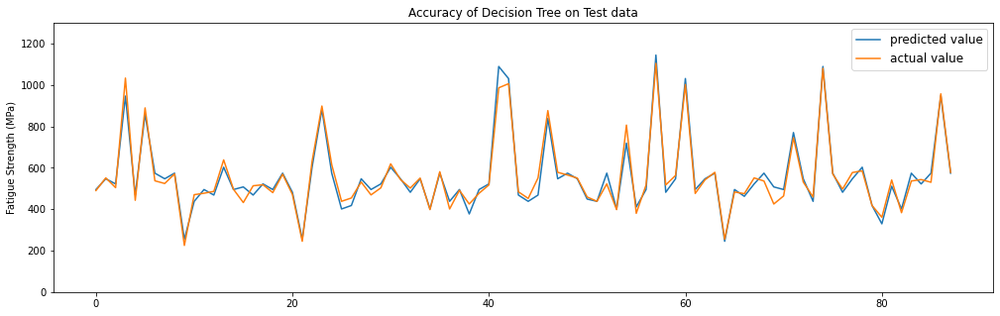

In [86]:
plt.plot(range(88), Y_pred_4)
plt.plot(range(88), y_test)
plt.ylim(0, 1300)
plt.ylabel('Fatigue Strength (MPa)')
L = plt.legend('upper right', prop={'size': 12})
L.get_texts()[0].set_text('predicted value')
L.get_texts()[1].set_text('actual value')
fig = plt.gcf()
fig.set_size_inches(17, 5)
plt.title('Accuracy of Decision Tree on Test data')
plt.savefig('DTTest.png')
plt.show()

In [87]:
independent_features = data[feature]
importance_dt = dict(zip(independent_features.columns, dtregr.feature_importances_))
importance_dt

{'NT': 0.020080233139532975,
 'THT': 0.0,
 'THt': 0.0,
 'THQCr': 0.0,
 'CT': 0.0,
 'Ct': 0.0007972127603637385,
 'DT': 0.0006802699275135031,
 'Dt': 0.723888863516302,
 'QmT': 0.0004636024066813628,
 'TT': 0.034575600946697135,
 'Tt': 0.0,
 'TCr': 0.0,
 'C': 0.07615052112568234,
 'Si': 0.0032939908821192536,
 'Mn': 0.003366293284125874,
 'P': 0.0171271376920196,
 'S': 0.0010304318171285181,
 'Ni': 2.108387695200153e-05,
 'Cr': 0.11169679547477672,
 'Cu': 0.0004989963325983208,
 'Mo': 0.0014184892408807606,
 'RedRatio': 0.0,
 'dA': 0.004420702726039885,
 'dB': 0.0002967072592713861,
 'dC': 0.00019306759131468258}

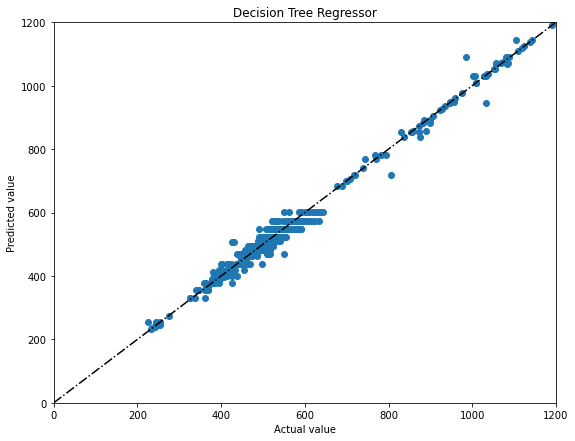

In [88]:
x = np.linspace(0, 1200, 1000)
plt.plot(x, x+0, '-.k')
plt.scatter(y, dtregr.predict(X))
plt.title("Decision Tree Regressor")
plt.xlabel("Actual value")
plt.ylabel("Predicted value")
fig = plt.gcf()
fig.set_size_inches(9, 7)
plt.xlim(0,1200)
plt.ylim(0,1200)
plt.savefig('DTScatter.png')

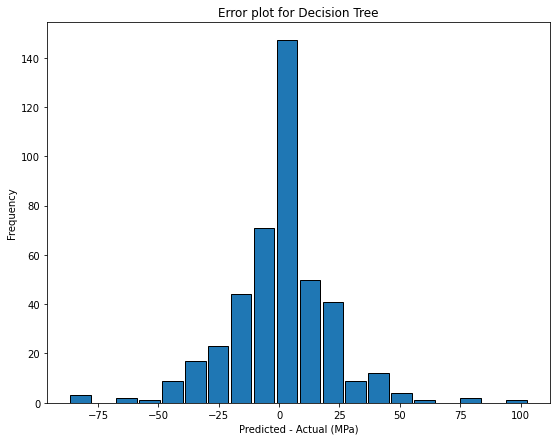

In [89]:
error_2 = dtregr.predict(X) - y
plt.hist(error_2, edgecolor='black', linewidth = 1.0, rwidth = 0.9, bins=20)
plt.title("Error plot for Decision Tree")
plt.xlabel("Predicted - Actual (MPa)")
plt.ylabel("Frequency")
fig = plt.gcf()
fig.set_size_inches(9, 7)
plt.savefig('DTError.png')

## Neural Network

    An Artificial Neural Network (ANN) is an information processing paradigm that is inspired by the way biological nervous systems, such as the brain, process information. The key element of this paradigm is the novel structure of the information processing system. It is composed of a large number of highly interconnected processing elements working in unison to solve specific problems. ANNs, like people, learn by example. An ANN is configured for a specific application, such as pattern recognition or data classification, through a learning process. Learning in biological systems involves adjustments to the synaptic connections that exist between the neurones. This is true of ANNs as well.

    Description of the ANN:

    Layer (type)      |          Output Shape |            Param  

    dense_1 (Dense)   |          (None, 512)  |            13312     
    dense_2 (Dense)   |          (None, 256)  |            131328    
    dense_3 (Dense)   |          (None, 128)  |            32896     
    dense_4 (Dense)   |          (None, 64)   |            8256      
    dense_5 (Dense)   |          (None, 01)   |            65        


    Total params: 185,857

    Trainable params: 185,857

    Non-trainable params: 0

In [90]:
import os
# Set the environment variable
os.environ['PROTOCOL_BUFFERS_PYTHON_IMPLEMENTATION'] = 'python'
# Install TensorFlow and protobuf


import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense

# Create the neural network model
NN_model = Sequential()

# The Input Layer:
NN_model.add(Dense(512, kernel_initializer='normal', input_dim=25, activation='relu'))

# The Hidden Layers:
NN_model.add(Dense(256, kernel_initializer='normal', activation='relu'))
NN_model.add(Dense(128, kernel_initializer='normal', activation='relu'))
NN_model.add(Dense(64, kernel_initializer='normal', activation='relu'))

# The Output Layer:
NN_model.add(Dense(1, kernel_initializer='normal', activation='linear'))

# Compile the network:
NN_model.compile(loss='mean_absolute_error', optimizer='adam', metrics=['mean_absolute_error'])

# Print model summary
NN_model.summary()


Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 512)               13312     
                                                                 
 dense_1 (Dense)             (None, 256)               131328    
                                                                 
 dense_2 (Dense)             (None, 128)               32896     
                                                                 
 dense_3 (Dense)             (None, 64)                8256      
                                                                 
 dense_4 (Dense)             (None, 1)                 65        
                                                                 
Total params: 185,857
Trainable params: 185,857
Non-trainable params: 0
_________________________________________________________________


In [91]:
checkpoint_name = 'Weights-{epoch:03d}--{val_loss:.5f}.hdf5' 
checkpoint = ModelCheckpoint(checkpoint_name, monitor='val_loss', verbose = 1, save_best_only = True, mode ='auto')
callbacks_list = [checkpoint]

In [92]:
NN_model.fit(X_train, y_train, epochs=1000, validation_split = 0.2, callbacks=callbacks_list)

Epoch 1/1000
1/9 [==>...........................] - ETA: 5s - loss: 555.6811 - mean_absolute_error: 555.6811
Epoch 00001: val_loss improved from inf to 573.76276, saving model to Weights-001--573.76276.hdf5
9/9 [==============================] - 1s 49ms/step - loss: 545.7045 - mean_absolute_error: 545.7045 - val_loss: 573.7628 - val_mean_absolute_error: 573.7628
Epoch 2/1000
1/9 [==>...........................] - ETA: 0s - loss: 544.9288 - mean_absolute_error: 544.9288
Epoch 00002: val_loss improved from 573.76276 to 563.35138, saving model to Weights-002--563.35138.hdf5
9/9 [==============================] - 0s 12ms/step - loss: 542.0110 - mean_absolute_error: 542.0110 - val_loss: 563.3514 - val_mean_absolute_error: 563.3514
Epoch 3/1000
1/9 [==>...........................] - ETA: 0s - loss: 565.0105 - mean_absolute_error: 565.0105
Epoch 00003: val_loss improved from 563.35138 to 507.70334, saving model to Weights-003--507.70334.hdf5
9/9 [==============================] - 0s 13ms/step

Epoch 25/1000
8/9 [=========================>....] - ETA: 0s - loss: 22.8284 - mean_absolute_error: 22.8284
Epoch 00025: val_loss did not improve from 31.05588
9/9 [==============================] - 0s 12ms/step - loss: 22.6099 - mean_absolute_error: 22.6099 - val_loss: 40.6502 - val_mean_absolute_error: 40.6502
Epoch 26/1000
1/9 [==>...........................] - ETA: 0s - loss: 26.1357 - mean_absolute_error: 26.1357
Epoch 00026: val_loss did not improve from 31.05588
9/9 [==============================] - 0s 8ms/step - loss: 23.9451 - mean_absolute_error: 23.9451 - val_loss: 34.9138 - val_mean_absolute_error: 34.9138
Epoch 27/1000
1/9 [==>...........................] - ETA: 0s - loss: 23.2852 - mean_absolute_error: 23.2852
Epoch 00027: val_loss did not improve from 31.05588
9/9 [==============================] - 0s 7ms/step - loss: 22.1126 - mean_absolute_error: 22.1126 - val_loss: 34.1204 - val_mean_absolute_error: 34.1204
Epoch 28/1000
1/9 [==>...........................] - ETA: 0s

Epoch 50/1000
1/9 [==>...........................] - ETA: 0s - loss: 16.2671 - mean_absolute_error: 16.2671
Epoch 00050: val_loss did not improve from 23.32599
9/9 [==============================] - 0s 6ms/step - loss: 15.8018 - mean_absolute_error: 15.8018 - val_loss: 31.6465 - val_mean_absolute_error: 31.6465
Epoch 51/1000
1/9 [==>...........................] - ETA: 0s - loss: 21.6416 - mean_absolute_error: 21.6416
Epoch 00051: val_loss did not improve from 23.32599
9/9 [==============================] - 0s 7ms/step - loss: 18.2906 - mean_absolute_error: 18.2906 - val_loss: 23.8500 - val_mean_absolute_error: 23.8500
Epoch 52/1000
1/9 [==>...........................] - ETA: 0s - loss: 20.0434 - mean_absolute_error: 20.0434
Epoch 00052: val_loss did not improve from 23.32599
9/9 [==============================] - 0s 7ms/step - loss: 16.7686 - mean_absolute_error: 16.7686 - val_loss: 28.4210 - val_mean_absolute_error: 28.4210
Epoch 53/1000
1/9 [==>...........................] - ETA: 0s 

Epoch 76/1000
1/9 [==>...........................] - ETA: 0s - loss: 11.7764 - mean_absolute_error: 11.7764
Epoch 00076: val_loss did not improve from 21.90998
9/9 [==============================] - 0s 10ms/step - loss: 13.6191 - mean_absolute_error: 13.6191 - val_loss: 22.8211 - val_mean_absolute_error: 22.8211
Epoch 77/1000
1/9 [==>...........................] - ETA: 0s - loss: 10.7446 - mean_absolute_error: 10.7446
Epoch 00077: val_loss did not improve from 21.90998
9/9 [==============================] - 0s 10ms/step - loss: 13.0348 - mean_absolute_error: 13.0348 - val_loss: 22.1605 - val_mean_absolute_error: 22.1605
Epoch 78/1000
1/9 [==>...........................] - ETA: 0s - loss: 12.9297 - mean_absolute_error: 12.9297
Epoch 00078: val_loss did not improve from 21.90998
9/9 [==============================] - 0s 9ms/step - loss: 14.3215 - mean_absolute_error: 14.3215 - val_loss: 23.7308 - val_mean_absolute_error: 23.7308
Epoch 79/1000
1/9 [==>...........................] - ETA: 0

1/9 [==>...........................] - ETA: 0s - loss: 12.7103 - mean_absolute_error: 12.7103
Epoch 00102: val_loss did not improve from 21.22170
9/9 [==============================] - 0s 7ms/step - loss: 11.8927 - mean_absolute_error: 11.8927 - val_loss: 21.9288 - val_mean_absolute_error: 21.9288
Epoch 103/1000
1/9 [==>...........................] - ETA: 0s - loss: 10.9577 - mean_absolute_error: 10.9577
Epoch 00103: val_loss did not improve from 21.22170
9/9 [==============================] - 0s 8ms/step - loss: 11.5097 - mean_absolute_error: 11.5097 - val_loss: 21.5739 - val_mean_absolute_error: 21.5739
Epoch 104/1000
1/9 [==>...........................] - ETA: 0s - loss: 9.7412 - mean_absolute_error: 9.7412
Epoch 00104: val_loss did not improve from 21.22170
9/9 [==============================] - 0s 7ms/step - loss: 11.6261 - mean_absolute_error: 11.6261 - val_loss: 22.1731 - val_mean_absolute_error: 22.1731
Epoch 105/1000
1/9 [==>...........................] - ETA: 0s - loss: 10.82

1/9 [==>...........................] - ETA: 0s - loss: 11.8023 - mean_absolute_error: 11.8023
Epoch 00128: val_loss did not improve from 21.22170
9/9 [==============================] - 0s 10ms/step - loss: 14.8519 - mean_absolute_error: 14.8519 - val_loss: 26.0000 - val_mean_absolute_error: 26.0000
Epoch 129/1000
1/9 [==>...........................] - ETA: 0s - loss: 17.6074 - mean_absolute_error: 17.6074
Epoch 00129: val_loss did not improve from 21.22170
9/9 [==============================] - 0s 8ms/step - loss: 14.7483 - mean_absolute_error: 14.7483 - val_loss: 22.7911 - val_mean_absolute_error: 22.7911
Epoch 130/1000
1/9 [==>...........................] - ETA: 0s - loss: 11.1949 - mean_absolute_error: 11.1949
Epoch 00130: val_loss did not improve from 21.22170
9/9 [==============================] - 0s 8ms/step - loss: 15.1412 - mean_absolute_error: 15.1412 - val_loss: 27.2140 - val_mean_absolute_error: 27.2140
Epoch 131/1000
1/9 [==>...........................] - ETA: 0s - loss: 17

1/9 [==>...........................] - ETA: 0s - loss: 10.3067 - mean_absolute_error: 10.3067
Epoch 00154: val_loss did not improve from 21.22170
9/9 [==============================] - 0s 9ms/step - loss: 10.2689 - mean_absolute_error: 10.2689 - val_loss: 22.1772 - val_mean_absolute_error: 22.1772
Epoch 155/1000
1/9 [==>...........................] - ETA: 0s - loss: 10.8202 - mean_absolute_error: 10.8202
Epoch 00155: val_loss did not improve from 21.22170
9/9 [==============================] - 0s 8ms/step - loss: 10.4058 - mean_absolute_error: 10.4058 - val_loss: 22.8017 - val_mean_absolute_error: 22.8017
Epoch 156/1000
1/9 [==>...........................] - ETA: 0s - loss: 8.7753 - mean_absolute_error: 8.7753
Epoch 00156: val_loss improved from 21.22170 to 21.00983, saving model to Weights-156--21.00983.hdf5
9/9 [==============================] - 0s 11ms/step - loss: 11.2704 - mean_absolute_error: 11.2704 - val_loss: 21.0098 - val_mean_absolute_error: 21.0098
Epoch 157/1000
1/9 [==>..

1/9 [==>...........................] - ETA: 0s - loss: 8.0340 - mean_absolute_error: 8.0340
Epoch 00180: val_loss did not improve from 21.00983
9/9 [==============================] - 0s 7ms/step - loss: 13.0045 - mean_absolute_error: 13.0045 - val_loss: 25.1999 - val_mean_absolute_error: 25.1999
Epoch 181/1000
1/9 [==>...........................] - ETA: 0s - loss: 10.6514 - mean_absolute_error: 10.6514
Epoch 00181: val_loss did not improve from 21.00983
9/9 [==============================] - 0s 7ms/step - loss: 11.3685 - mean_absolute_error: 11.3685 - val_loss: 24.2796 - val_mean_absolute_error: 24.2796
Epoch 182/1000
1/9 [==>...........................] - ETA: 0s - loss: 14.9887 - mean_absolute_error: 14.9887
Epoch 00182: val_loss did not improve from 21.00983
9/9 [==============================] - 0s 7ms/step - loss: 11.7290 - mean_absolute_error: 11.7290 - val_loss: 21.5480 - val_mean_absolute_error: 21.5480
Epoch 183/1000
1/9 [==>...........................] - ETA: 0s - loss: 7.686

1/9 [==>...........................] - ETA: 0s - loss: 12.7853 - mean_absolute_error: 12.7853
Epoch 00206: val_loss did not improve from 21.00983
9/9 [==============================] - 0s 8ms/step - loss: 9.9226 - mean_absolute_error: 9.9226 - val_loss: 23.3570 - val_mean_absolute_error: 23.3570
Epoch 207/1000
1/9 [==>...........................] - ETA: 0s - loss: 13.4250 - mean_absolute_error: 13.4250
Epoch 00207: val_loss did not improve from 21.00983
9/9 [==============================] - 0s 7ms/step - loss: 10.1129 - mean_absolute_error: 10.1129 - val_loss: 22.1547 - val_mean_absolute_error: 22.1547
Epoch 208/1000
1/9 [==>...........................] - ETA: 0s - loss: 11.1696 - mean_absolute_error: 11.1696
Epoch 00208: val_loss did not improve from 21.00983
9/9 [==============================] - 0s 7ms/step - loss: 9.9346 - mean_absolute_error: 9.9346 - val_loss: 22.5685 - val_mean_absolute_error: 22.5685
Epoch 209/1000
1/9 [==>...........................] - ETA: 0s - loss: 11.3954

1/9 [==>...........................] - ETA: 0s - loss: 20.5536 - mean_absolute_error: 20.5536
Epoch 00232: val_loss did not improve from 21.00983
9/9 [==============================] - 0s 8ms/step - loss: 12.9969 - mean_absolute_error: 12.9969 - val_loss: 26.1426 - val_mean_absolute_error: 26.1426
Epoch 233/1000
1/9 [==>...........................] - ETA: 0s - loss: 12.3292 - mean_absolute_error: 12.3292
Epoch 00233: val_loss did not improve from 21.00983
9/9 [==============================] - 0s 7ms/step - loss: 11.0951 - mean_absolute_error: 11.0951 - val_loss: 23.9751 - val_mean_absolute_error: 23.9751
Epoch 234/1000
1/9 [==>...........................] - ETA: 0s - loss: 9.6600 - mean_absolute_error: 9.6600
Epoch 00234: val_loss did not improve from 21.00983
9/9 [==============================] - 0s 9ms/step - loss: 9.4545 - mean_absolute_error: 9.4545 - val_loss: 23.1033 - val_mean_absolute_error: 23.1033
Epoch 235/1000
1/9 [==>...........................] - ETA: 0s - loss: 7.9825 

1/9 [==>...........................] - ETA: 0s - loss: 10.4644 - mean_absolute_error: 10.4644
Epoch 00258: val_loss did not improve from 21.00983
9/9 [==============================] - 0s 7ms/step - loss: 10.0103 - mean_absolute_error: 10.0103 - val_loss: 22.5139 - val_mean_absolute_error: 22.5139
Epoch 259/1000
1/9 [==>...........................] - ETA: 0s - loss: 11.7617 - mean_absolute_error: 11.7617
Epoch 00259: val_loss did not improve from 21.00983
9/9 [==============================] - 0s 6ms/step - loss: 9.8052 - mean_absolute_error: 9.8052 - val_loss: 22.4402 - val_mean_absolute_error: 22.4402
Epoch 260/1000
1/9 [==>...........................] - ETA: 0s - loss: 9.8073 - mean_absolute_error: 9.8073
Epoch 00260: val_loss did not improve from 21.00983
9/9 [==============================] - 0s 7ms/step - loss: 9.6626 - mean_absolute_error: 9.6626 - val_loss: 23.9375 - val_mean_absolute_error: 23.9375
Epoch 261/1000
1/9 [==>...........................] - ETA: 0s - loss: 9.0468 - 

1/9 [==>...........................] - ETA: 0s - loss: 9.6104 - mean_absolute_error: 9.6104
Epoch 00284: val_loss did not improve from 21.00983
9/9 [==============================] - 0s 7ms/step - loss: 11.8222 - mean_absolute_error: 11.8222 - val_loss: 23.1021 - val_mean_absolute_error: 23.1021
Epoch 285/1000
1/9 [==>...........................] - ETA: 0s - loss: 7.1226 - mean_absolute_error: 7.1226
Epoch 00285: val_loss did not improve from 21.00983
9/9 [==============================] - 0s 8ms/step - loss: 9.2860 - mean_absolute_error: 9.2860 - val_loss: 22.2662 - val_mean_absolute_error: 22.2662
Epoch 286/1000
1/9 [==>...........................] - ETA: 0s - loss: 9.8666 - mean_absolute_error: 9.8666
Epoch 00286: val_loss did not improve from 21.00983
9/9 [==============================] - 0s 9ms/step - loss: 10.4555 - mean_absolute_error: 10.4555 - val_loss: 22.7237 - val_mean_absolute_error: 22.7237
Epoch 287/1000
1/9 [==>...........................] - ETA: 0s - loss: 10.4441 - m

1/9 [==>...........................] - ETA: 0s - loss: 10.8265 - mean_absolute_error: 10.8265
Epoch 00310: val_loss did not improve from 21.00983
9/9 [==============================] - 0s 7ms/step - loss: 9.2407 - mean_absolute_error: 9.2407 - val_loss: 22.4052 - val_mean_absolute_error: 22.4052
Epoch 311/1000
1/9 [==>...........................] - ETA: 0s - loss: 7.6498 - mean_absolute_error: 7.6498
Epoch 00311: val_loss did not improve from 21.00983
9/9 [==============================] - 0s 7ms/step - loss: 8.9702 - mean_absolute_error: 8.9702 - val_loss: 22.8841 - val_mean_absolute_error: 22.8841
Epoch 312/1000
1/9 [==>...........................] - ETA: 0s - loss: 7.5687 - mean_absolute_error: 7.5687
Epoch 00312: val_loss did not improve from 21.00983
9/9 [==============================] - 0s 7ms/step - loss: 9.7303 - mean_absolute_error: 9.7303 - val_loss: 23.1861 - val_mean_absolute_error: 23.1861
Epoch 313/1000
1/9 [==>...........................] - ETA: 0s - loss: 8.2377 - mean

Epoch 00336: val_loss did not improve from 21.00983
9/9 [==============================] - 0s 8ms/step - loss: 8.9509 - mean_absolute_error: 8.9509 - val_loss: 23.3063 - val_mean_absolute_error: 23.3063
Epoch 337/1000
1/9 [==>...........................] - ETA: 0s - loss: 7.7093 - mean_absolute_error: 7.7093
Epoch 00337: val_loss did not improve from 21.00983
9/9 [==============================] - 0s 8ms/step - loss: 8.4138 - mean_absolute_error: 8.4138 - val_loss: 22.5191 - val_mean_absolute_error: 22.5191
Epoch 338/1000
1/9 [==>...........................] - ETA: 0s - loss: 9.0777 - mean_absolute_error: 9.0777
Epoch 00338: val_loss did not improve from 21.00983
9/9 [==============================] - 0s 7ms/step - loss: 9.3457 - mean_absolute_error: 9.3457 - val_loss: 24.0685 - val_mean_absolute_error: 24.0685
Epoch 339/1000
1/9 [==>...........................] - ETA: 0s - loss: 12.0240 - mean_absolute_error: 12.0240
Epoch 00339: val_loss did not improve from 21.00983
9/9 [===========

Epoch 363/1000
1/9 [==>...........................] - ETA: 0s - loss: 9.7878 - mean_absolute_error: 9.7878
Epoch 00363: val_loss did not improve from 21.00983
9/9 [==============================] - 0s 9ms/step - loss: 9.4001 - mean_absolute_error: 9.4001 - val_loss: 22.4848 - val_mean_absolute_error: 22.4848
Epoch 364/1000
1/9 [==>...........................] - ETA: 0s - loss: 9.1647 - mean_absolute_error: 9.1647
Epoch 00364: val_loss did not improve from 21.00983
9/9 [==============================] - 0s 8ms/step - loss: 9.4109 - mean_absolute_error: 9.4109 - val_loss: 22.6957 - val_mean_absolute_error: 22.6957
Epoch 365/1000
1/9 [==>...........................] - ETA: 0s - loss: 7.9009 - mean_absolute_error: 7.9009
Epoch 00365: val_loss did not improve from 21.00983
9/9 [==============================] - 0s 8ms/step - loss: 9.8131 - mean_absolute_error: 9.8131 - val_loss: 22.1542 - val_mean_absolute_error: 22.1542
Epoch 366/1000
1/9 [==>...........................] - ETA: 0s - loss: 

1/9 [==>...........................] - ETA: 0s - loss: 9.0314 - mean_absolute_error: 9.0314
Epoch 00389: val_loss did not improve from 21.00983
9/9 [==============================] - 0s 8ms/step - loss: 8.7650 - mean_absolute_error: 8.7650 - val_loss: 22.3358 - val_mean_absolute_error: 22.3358
Epoch 390/1000
1/9 [==>...........................] - ETA: 0s - loss: 7.4024 - mean_absolute_error: 7.4024
Epoch 00390: val_loss did not improve from 21.00983
9/9 [==============================] - 0s 8ms/step - loss: 8.4016 - mean_absolute_error: 8.4016 - val_loss: 23.5269 - val_mean_absolute_error: 23.5269
Epoch 391/1000
1/9 [==>...........................] - ETA: 0s - loss: 7.9496 - mean_absolute_error: 7.9496
Epoch 00391: val_loss did not improve from 21.00983
9/9 [==============================] - 0s 8ms/step - loss: 8.6435 - mean_absolute_error: 8.6435 - val_loss: 22.6685 - val_mean_absolute_error: 22.6685
Epoch 392/1000
1/9 [==>...........................] - ETA: 0s - loss: 7.5646 - mean_a

Epoch 416/1000
1/9 [==>...........................] - ETA: 0s - loss: 8.2798 - mean_absolute_error: 8.2798
Epoch 00416: val_loss did not improve from 21.00983
9/9 [==============================] - 0s 8ms/step - loss: 9.8533 - mean_absolute_error: 9.8533 - val_loss: 22.2744 - val_mean_absolute_error: 22.2744
Epoch 417/1000
1/9 [==>...........................] - ETA: 0s - loss: 7.1071 - mean_absolute_error: 7.1071
Epoch 00417: val_loss did not improve from 21.00983
9/9 [==============================] - 0s 8ms/step - loss: 10.9121 - mean_absolute_error: 10.9121 - val_loss: 23.5655 - val_mean_absolute_error: 23.5655
Epoch 418/1000
1/9 [==>...........................] - ETA: 0s - loss: 11.9406 - mean_absolute_error: 11.9406
Epoch 00418: val_loss did not improve from 21.00983
9/9 [==============================] - 0s 8ms/step - loss: 11.2488 - mean_absolute_error: 11.2488 - val_loss: 24.0114 - val_mean_absolute_error: 24.0114
Epoch 419/1000
1/9 [==>...........................] - ETA: 0s - 

1/9 [==>...........................] - ETA: 0s - loss: 6.2311 - mean_absolute_error: 6.2311
Epoch 00442: val_loss did not improve from 21.00983
9/9 [==============================] - 0s 7ms/step - loss: 7.9027 - mean_absolute_error: 7.9027 - val_loss: 22.6975 - val_mean_absolute_error: 22.6975
Epoch 443/1000
1/9 [==>...........................] - ETA: 0s - loss: 7.6139 - mean_absolute_error: 7.6139
Epoch 00443: val_loss did not improve from 21.00983
9/9 [==============================] - 0s 8ms/step - loss: 7.7757 - mean_absolute_error: 7.7757 - val_loss: 22.5100 - val_mean_absolute_error: 22.5100
Epoch 444/1000
1/9 [==>...........................] - ETA: 0s - loss: 9.5669 - mean_absolute_error: 9.5669
Epoch 00444: val_loss did not improve from 21.00983
9/9 [==============================] - 0s 7ms/step - loss: 10.7694 - mean_absolute_error: 10.7694 - val_loss: 22.3630 - val_mean_absolute_error: 22.3630
Epoch 445/1000
1/9 [==>...........................] - ETA: 0s - loss: 7.8444 - mean

Epoch 469/1000
1/9 [==>...........................] - ETA: 0s - loss: 7.0238 - mean_absolute_error: 7.0238
Epoch 00469: val_loss did not improve from 21.00983
9/9 [==============================] - 0s 7ms/step - loss: 10.2868 - mean_absolute_error: 10.2868 - val_loss: 23.2952 - val_mean_absolute_error: 23.2952
Epoch 470/1000
1/9 [==>...........................] - ETA: 0s - loss: 8.9724 - mean_absolute_error: 8.9724
Epoch 00470: val_loss did not improve from 21.00983
9/9 [==============================] - 0s 7ms/step - loss: 8.8743 - mean_absolute_error: 8.8743 - val_loss: 22.3811 - val_mean_absolute_error: 22.3811
Epoch 471/1000
1/9 [==>...........................] - ETA: 0s - loss: 7.8582 - mean_absolute_error: 7.8582
Epoch 00471: val_loss did not improve from 21.00983
9/9 [==============================] - 0s 8ms/step - loss: 7.9527 - mean_absolute_error: 7.9527 - val_loss: 22.1583 - val_mean_absolute_error: 22.1583
Epoch 472/1000
1/9 [==>...........................] - ETA: 0s - loss

Epoch 496/1000
1/9 [==>...........................] - ETA: 0s - loss: 14.7255 - mean_absolute_error: 14.7255
Epoch 00496: val_loss did not improve from 21.00983
9/9 [==============================] - 0s 7ms/step - loss: 12.9283 - mean_absolute_error: 12.9283 - val_loss: 26.5894 - val_mean_absolute_error: 26.5894
Epoch 497/1000
1/9 [==>...........................] - ETA: 0s - loss: 11.8795 - mean_absolute_error: 11.8795
Epoch 00497: val_loss did not improve from 21.00983
9/9 [==============================] - 0s 7ms/step - loss: 12.3822 - mean_absolute_error: 12.3822 - val_loss: 23.0214 - val_mean_absolute_error: 23.0214
Epoch 498/1000
1/9 [==>...........................] - ETA: 0s - loss: 8.8485 - mean_absolute_error: 8.8485
Epoch 00498: val_loss did not improve from 21.00983
9/9 [==============================] - 0s 8ms/step - loss: 10.3898 - mean_absolute_error: 10.3898 - val_loss: 22.3062 - val_mean_absolute_error: 22.3062
Epoch 499/1000
1/9 [==>...........................] - ETA: 0

1/9 [==>...........................] - ETA: 0s - loss: 7.8964 - mean_absolute_error: 7.8964
Epoch 00522: val_loss did not improve from 21.00983
9/9 [==============================] - 0s 8ms/step - loss: 7.8025 - mean_absolute_error: 7.8025 - val_loss: 22.9790 - val_mean_absolute_error: 22.9790
Epoch 523/1000
1/9 [==>...........................] - ETA: 0s - loss: 6.6779 - mean_absolute_error: 6.6779
Epoch 00523: val_loss did not improve from 21.00983
9/9 [==============================] - 0s 9ms/step - loss: 6.8681 - mean_absolute_error: 6.8681 - val_loss: 21.8470 - val_mean_absolute_error: 21.8470
Epoch 524/1000
1/9 [==>...........................] - ETA: 0s - loss: 9.7909 - mean_absolute_error: 9.7909
Epoch 00524: val_loss did not improve from 21.00983
9/9 [==============================] - 0s 8ms/step - loss: 8.6889 - mean_absolute_error: 8.6889 - val_loss: 25.2441 - val_mean_absolute_error: 25.2441
Epoch 525/1000
1/9 [==>...........................] - ETA: 0s - loss: 15.2153 - mean_

Epoch 549/1000
1/9 [==>...........................] - ETA: 0s - loss: 4.7573 - mean_absolute_error: 4.7573
Epoch 00549: val_loss did not improve from 21.00983
9/9 [==============================] - 0s 7ms/step - loss: 7.6616 - mean_absolute_error: 7.6616 - val_loss: 23.1567 - val_mean_absolute_error: 23.1567
Epoch 550/1000
1/9 [==>...........................] - ETA: 0s - loss: 9.6961 - mean_absolute_error: 9.6961
Epoch 00550: val_loss did not improve from 21.00983
9/9 [==============================] - 0s 8ms/step - loss: 8.7435 - mean_absolute_error: 8.7435 - val_loss: 22.2477 - val_mean_absolute_error: 22.2477
Epoch 551/1000
1/9 [==>...........................] - ETA: 0s - loss: 7.3195 - mean_absolute_error: 7.3195
Epoch 00551: val_loss did not improve from 21.00983
9/9 [==============================] - 0s 9ms/step - loss: 9.2871 - mean_absolute_error: 9.2871 - val_loss: 22.8705 - val_mean_absolute_error: 22.8705
Epoch 552/1000
1/9 [==>...........................] - ETA: 0s - loss: 

Epoch 576/1000
1/9 [==>...........................] - ETA: 0s - loss: 7.7122 - mean_absolute_error: 7.7122
Epoch 00576: val_loss did not improve from 21.00983
9/9 [==============================] - 0s 8ms/step - loss: 7.7889 - mean_absolute_error: 7.7889 - val_loss: 23.6808 - val_mean_absolute_error: 23.6808
Epoch 577/1000
1/9 [==>...........................] - ETA: 0s - loss: 8.3290 - mean_absolute_error: 8.3290
Epoch 00577: val_loss did not improve from 21.00983
9/9 [==============================] - 0s 8ms/step - loss: 7.7565 - mean_absolute_error: 7.7565 - val_loss: 23.3714 - val_mean_absolute_error: 23.3714
Epoch 578/1000
1/9 [==>...........................] - ETA: 0s - loss: 7.8169 - mean_absolute_error: 7.8169
Epoch 00578: val_loss did not improve from 21.00983
9/9 [==============================] - 0s 11ms/step - loss: 8.2289 - mean_absolute_error: 8.2289 - val_loss: 23.4819 - val_mean_absolute_error: 23.4819
Epoch 579/1000
1/9 [==>...........................] - ETA: 0s - loss:

Epoch 603/1000
1/9 [==>...........................] - ETA: 0s - loss: 5.8146 - mean_absolute_error: 5.8146
Epoch 00603: val_loss did not improve from 21.00983
9/9 [==============================] - 0s 7ms/step - loss: 7.7952 - mean_absolute_error: 7.7952 - val_loss: 23.2019 - val_mean_absolute_error: 23.2019
Epoch 604/1000
1/9 [==>...........................] - ETA: 0s - loss: 9.0945 - mean_absolute_error: 9.0945
Epoch 00604: val_loss did not improve from 21.00983
9/9 [==============================] - 0s 9ms/step - loss: 8.0196 - mean_absolute_error: 8.0196 - val_loss: 23.4306 - val_mean_absolute_error: 23.4306
Epoch 605/1000
1/9 [==>...........................] - ETA: 0s - loss: 8.1959 - mean_absolute_error: 8.1959
Epoch 00605: val_loss did not improve from 21.00983
9/9 [==============================] - 0s 9ms/step - loss: 8.1507 - mean_absolute_error: 8.1507 - val_loss: 22.1669 - val_mean_absolute_error: 22.1669
Epoch 606/1000
1/9 [==>...........................] - ETA: 0s - loss: 

9/9 [==============================] - 0s 7ms/step - loss: 8.2865 - mean_absolute_error: 8.2865 - val_loss: 21.9400 - val_mean_absolute_error: 21.9400
Epoch 630/1000
1/9 [==>...........................] - ETA: 0s - loss: 10.4457 - mean_absolute_error: 10.4457
Epoch 00630: val_loss did not improve from 21.00983
9/9 [==============================] - 0s 7ms/step - loss: 8.2616 - mean_absolute_error: 8.2616 - val_loss: 23.8733 - val_mean_absolute_error: 23.8733
Epoch 631/1000
1/9 [==>...........................] - ETA: 0s - loss: 8.3764 - mean_absolute_error: 8.3764
Epoch 00631: val_loss did not improve from 21.00983
9/9 [==============================] - 0s 8ms/step - loss: 7.6604 - mean_absolute_error: 7.6604 - val_loss: 23.3285 - val_mean_absolute_error: 23.3285
Epoch 632/1000
1/9 [==>...........................] - ETA: 0s - loss: 9.2998 - mean_absolute_error: 9.2998
Epoch 00632: val_loss did not improve from 21.00983
9/9 [==============================] - 0s 9ms/step - loss: 9.3576 - 

Epoch 656/1000
1/9 [==>...........................] - ETA: 0s - loss: 10.9996 - mean_absolute_error: 10.9996
Epoch 00656: val_loss did not improve from 21.00983
9/9 [==============================] - 0s 9ms/step - loss: 8.2714 - mean_absolute_error: 8.2714 - val_loss: 22.8931 - val_mean_absolute_error: 22.8931
Epoch 657/1000
1/9 [==>...........................] - ETA: 0s - loss: 5.3926 - mean_absolute_error: 5.3926
Epoch 00657: val_loss did not improve from 21.00983
9/9 [==============================] - 0s 9ms/step - loss: 6.7532 - mean_absolute_error: 6.7532 - val_loss: 21.8455 - val_mean_absolute_error: 21.8455
Epoch 658/1000
1/9 [==>...........................] - ETA: 0s - loss: 6.1562 - mean_absolute_error: 6.1562
Epoch 00658: val_loss did not improve from 21.00983
9/9 [==============================] - 0s 7ms/step - loss: 6.4531 - mean_absolute_error: 6.4531 - val_loss: 22.8581 - val_mean_absolute_error: 22.8581
Epoch 659/1000
1/9 [==>...........................] - ETA: 0s - loss

Epoch 683/1000
1/9 [==>...........................] - ETA: 0s - loss: 12.7366 - mean_absolute_error: 12.7366
Epoch 00683: val_loss did not improve from 21.00983
9/9 [==============================] - 0s 7ms/step - loss: 11.4543 - mean_absolute_error: 11.4543 - val_loss: 22.4857 - val_mean_absolute_error: 22.4857
Epoch 684/1000
1/9 [==>...........................] - ETA: 0s - loss: 5.3515 - mean_absolute_error: 5.3515
Epoch 00684: val_loss did not improve from 21.00983
9/9 [==============================] - 0s 8ms/step - loss: 10.0463 - mean_absolute_error: 10.0463 - val_loss: 26.6948 - val_mean_absolute_error: 26.6948
Epoch 685/1000
1/9 [==>...........................] - ETA: 0s - loss: 13.6251 - mean_absolute_error: 13.6251
Epoch 00685: val_loss did not improve from 21.00983
9/9 [==============================] - 0s 7ms/step - loss: 9.1815 - mean_absolute_error: 9.1815 - val_loss: 23.3602 - val_mean_absolute_error: 23.3602
Epoch 686/1000
1/9 [==>...........................] - ETA: 0s 

1/9 [==>...........................] - ETA: 0s - loss: 6.8605 - mean_absolute_error: 6.8605
Epoch 00709: val_loss did not improve from 20.99814
9/9 [==============================] - 0s 8ms/step - loss: 7.4686 - mean_absolute_error: 7.4686 - val_loss: 22.0857 - val_mean_absolute_error: 22.0857
Epoch 710/1000
1/9 [==>...........................] - ETA: 0s - loss: 9.1788 - mean_absolute_error: 9.1788
Epoch 00710: val_loss did not improve from 20.99814
9/9 [==============================] - 0s 9ms/step - loss: 6.8713 - mean_absolute_error: 6.8713 - val_loss: 21.8200 - val_mean_absolute_error: 21.8200
Epoch 711/1000
1/9 [==>...........................] - ETA: 0s - loss: 6.7411 - mean_absolute_error: 6.7411
Epoch 00711: val_loss did not improve from 20.99814
9/9 [==============================] - 0s 9ms/step - loss: 6.9810 - mean_absolute_error: 6.9810 - val_loss: 23.9142 - val_mean_absolute_error: 23.9142
Epoch 712/1000
1/9 [==>...........................] - ETA: 0s - loss: 12.1203 - mean_

Epoch 736/1000
1/9 [==>...........................] - ETA: 0s - loss: 7.8027 - mean_absolute_error: 7.8027
Epoch 00736: val_loss did not improve from 20.99814
9/9 [==============================] - 0s 8ms/step - loss: 7.8133 - mean_absolute_error: 7.8133 - val_loss: 25.2175 - val_mean_absolute_error: 25.2175
Epoch 737/1000
1/9 [==>...........................] - ETA: 0s - loss: 10.8690 - mean_absolute_error: 10.8690
Epoch 00737: val_loss did not improve from 20.99814
9/9 [==============================] - 0s 7ms/step - loss: 7.0482 - mean_absolute_error: 7.0482 - val_loss: 22.2525 - val_mean_absolute_error: 22.2525
Epoch 738/1000
1/9 [==>...........................] - ETA: 0s - loss: 7.3416 - mean_absolute_error: 7.3416
Epoch 00738: val_loss did not improve from 20.99814
9/9 [==============================] - 0s 7ms/step - loss: 8.0731 - mean_absolute_error: 8.0731 - val_loss: 23.3850 - val_mean_absolute_error: 23.3850
Epoch 739/1000
1/9 [==>...........................] - ETA: 0s - loss

Epoch 763/1000
1/9 [==>...........................] - ETA: 0s - loss: 5.1970 - mean_absolute_error: 5.1970
Epoch 00763: val_loss did not improve from 20.99814
9/9 [==============================] - 0s 7ms/step - loss: 7.3703 - mean_absolute_error: 7.3703 - val_loss: 24.4849 - val_mean_absolute_error: 24.4849
Epoch 764/1000
1/9 [==>...........................] - ETA: 0s - loss: 8.9958 - mean_absolute_error: 8.9958
Epoch 00764: val_loss did not improve from 20.99814
9/9 [==============================] - 0s 7ms/step - loss: 8.0068 - mean_absolute_error: 8.0068 - val_loss: 22.4326 - val_mean_absolute_error: 22.4326
Epoch 765/1000
1/9 [==>...........................] - ETA: 0s - loss: 7.8062 - mean_absolute_error: 7.8062
Epoch 00765: val_loss did not improve from 20.99814
9/9 [==============================] - 0s 9ms/step - loss: 8.2304 - mean_absolute_error: 8.2304 - val_loss: 22.7347 - val_mean_absolute_error: 22.7347
Epoch 766/1000
1/9 [==>...........................] - ETA: 0s - loss: 

Epoch 790/1000
1/9 [==>...........................] - ETA: 0s - loss: 8.6080 - mean_absolute_error: 8.6080
Epoch 00790: val_loss did not improve from 20.99814
9/9 [==============================] - 0s 8ms/step - loss: 7.1174 - mean_absolute_error: 7.1174 - val_loss: 21.8259 - val_mean_absolute_error: 21.8259
Epoch 791/1000
1/9 [==>...........................] - ETA: 0s - loss: 8.9220 - mean_absolute_error: 8.9220
Epoch 00791: val_loss did not improve from 20.99814
9/9 [==============================] - 0s 7ms/step - loss: 7.5739 - mean_absolute_error: 7.5739 - val_loss: 23.5180 - val_mean_absolute_error: 23.5180
Epoch 792/1000
1/9 [==>...........................] - ETA: 0s - loss: 8.2996 - mean_absolute_error: 8.2996
Epoch 00792: val_loss did not improve from 20.99814
9/9 [==============================] - 0s 8ms/step - loss: 6.4718 - mean_absolute_error: 6.4718 - val_loss: 22.6640 - val_mean_absolute_error: 22.6640
Epoch 793/1000
1/9 [==>...........................] - ETA: 0s - loss: 

Epoch 817/1000
1/9 [==>...........................] - ETA: 0s - loss: 8.2866 - mean_absolute_error: 8.2866
Epoch 00817: val_loss did not improve from 20.99814
9/9 [==============================] - 0s 9ms/step - loss: 5.9563 - mean_absolute_error: 5.9563 - val_loss: 22.6555 - val_mean_absolute_error: 22.6555
Epoch 818/1000
1/9 [==>...........................] - ETA: 0s - loss: 7.3433 - mean_absolute_error: 7.3433
Epoch 00818: val_loss did not improve from 20.99814
9/9 [==============================] - 0s 8ms/step - loss: 6.6871 - mean_absolute_error: 6.6871 - val_loss: 22.4104 - val_mean_absolute_error: 22.4104
Epoch 819/1000
1/9 [==>...........................] - ETA: 0s - loss: 6.0947 - mean_absolute_error: 6.0947
Epoch 00819: val_loss did not improve from 20.99814
9/9 [==============================] - 0s 8ms/step - loss: 7.4750 - mean_absolute_error: 7.4750 - val_loss: 24.0626 - val_mean_absolute_error: 24.0626
Epoch 820/1000
1/9 [==>...........................] - ETA: 0s - loss: 

Epoch 844/1000
1/9 [==>...........................] - ETA: 0s - loss: 12.0667 - mean_absolute_error: 12.0667
Epoch 00844: val_loss did not improve from 20.99814
9/9 [==============================] - 0s 8ms/step - loss: 8.1574 - mean_absolute_error: 8.1574 - val_loss: 22.5674 - val_mean_absolute_error: 22.5674
Epoch 845/1000
1/9 [==>...........................] - ETA: 0s - loss: 8.9643 - mean_absolute_error: 8.9643
Epoch 00845: val_loss did not improve from 20.99814
9/9 [==============================] - 0s 7ms/step - loss: 7.4753 - mean_absolute_error: 7.4753 - val_loss: 23.1812 - val_mean_absolute_error: 23.1812
Epoch 846/1000
1/9 [==>...........................] - ETA: 0s - loss: 5.6337 - mean_absolute_error: 5.6337
Epoch 00846: val_loss did not improve from 20.99814
9/9 [==============================] - 0s 7ms/step - loss: 8.1416 - mean_absolute_error: 8.1416 - val_loss: 23.6859 - val_mean_absolute_error: 23.6859
Epoch 847/1000
1/9 [==>...........................] - ETA: 0s - loss

Epoch 871/1000
1/9 [==>...........................] - ETA: 0s - loss: 8.9593 - mean_absolute_error: 8.9593
Epoch 00871: val_loss did not improve from 20.99814
9/9 [==============================] - 0s 8ms/step - loss: 7.9346 - mean_absolute_error: 7.9346 - val_loss: 23.8937 - val_mean_absolute_error: 23.8937
Epoch 872/1000
1/9 [==>...........................] - ETA: 0s - loss: 8.5743 - mean_absolute_error: 8.5743
Epoch 00872: val_loss did not improve from 20.99814
9/9 [==============================] - 0s 8ms/step - loss: 7.6466 - mean_absolute_error: 7.6466 - val_loss: 22.7741 - val_mean_absolute_error: 22.7741
Epoch 873/1000
1/9 [==>...........................] - ETA: 0s - loss: 7.1157 - mean_absolute_error: 7.1157
Epoch 00873: val_loss did not improve from 20.99814
9/9 [==============================] - 0s 7ms/step - loss: 9.1379 - mean_absolute_error: 9.1379 - val_loss: 23.6804 - val_mean_absolute_error: 23.6804
Epoch 874/1000
1/9 [==>...........................] - ETA: 0s - loss: 

Epoch 898/1000
1/9 [==>...........................] - ETA: 0s - loss: 5.7722 - mean_absolute_error: 5.7722
Epoch 00898: val_loss did not improve from 20.99814
9/9 [==============================] - 0s 8ms/step - loss: 6.2019 - mean_absolute_error: 6.2019 - val_loss: 22.3177 - val_mean_absolute_error: 22.3177
Epoch 899/1000
1/9 [==>...........................] - ETA: 0s - loss: 5.0290 - mean_absolute_error: 5.0290
Epoch 00899: val_loss did not improve from 20.99814
9/9 [==============================] - 0s 7ms/step - loss: 6.7247 - mean_absolute_error: 6.7247 - val_loss: 24.1526 - val_mean_absolute_error: 24.1526
Epoch 900/1000
1/9 [==>...........................] - ETA: 0s - loss: 5.6247 - mean_absolute_error: 5.6247
Epoch 00900: val_loss did not improve from 20.99814
9/9 [==============================] - 0s 7ms/step - loss: 6.9790 - mean_absolute_error: 6.9790 - val_loss: 22.9666 - val_mean_absolute_error: 22.9666
Epoch 901/1000
1/9 [==>...........................] - ETA: 0s - loss: 

Epoch 925/1000
1/9 [==>...........................] - ETA: 0s - loss: 6.2360 - mean_absolute_error: 6.2360
Epoch 00925: val_loss did not improve from 20.99814
9/9 [==============================] - 0s 8ms/step - loss: 8.1113 - mean_absolute_error: 8.1113 - val_loss: 24.2855 - val_mean_absolute_error: 24.2855
Epoch 926/1000
1/9 [==>...........................] - ETA: 0s - loss: 10.0654 - mean_absolute_error: 10.0654
Epoch 00926: val_loss did not improve from 20.99814
9/9 [==============================] - 0s 7ms/step - loss: 10.7049 - mean_absolute_error: 10.7049 - val_loss: 23.2028 - val_mean_absolute_error: 23.2028
Epoch 927/1000
1/9 [==>...........................] - ETA: 0s - loss: 13.6983 - mean_absolute_error: 13.6983
Epoch 00927: val_loss did not improve from 20.99814
9/9 [==============================] - 0s 7ms/step - loss: 8.7634 - mean_absolute_error: 8.7634 - val_loss: 25.1377 - val_mean_absolute_error: 25.1377
Epoch 928/1000
1/9 [==>...........................] - ETA: 0s - 

Epoch 952/1000
1/9 [==>...........................] - ETA: 0s - loss: 8.3939 - mean_absolute_error: 8.3939
Epoch 00952: val_loss did not improve from 20.99814
9/9 [==============================] - 0s 7ms/step - loss: 8.5274 - mean_absolute_error: 8.5274 - val_loss: 23.0933 - val_mean_absolute_error: 23.0933
Epoch 953/1000
1/9 [==>...........................] - ETA: 0s - loss: 5.5912 - mean_absolute_error: 5.5912
Epoch 00953: val_loss did not improve from 20.99814
9/9 [==============================] - 0s 7ms/step - loss: 6.6547 - mean_absolute_error: 6.6547 - val_loss: 23.7033 - val_mean_absolute_error: 23.7033
Epoch 954/1000
1/9 [==>...........................] - ETA: 0s - loss: 6.8783 - mean_absolute_error: 6.8783
Epoch 00954: val_loss did not improve from 20.99814
9/9 [==============================] - 0s 7ms/step - loss: 6.3123 - mean_absolute_error: 6.3123 - val_loss: 23.0136 - val_mean_absolute_error: 23.0136
Epoch 955/1000
1/9 [==>...........................] - ETA: 0s - loss: 

Epoch 979/1000
1/9 [==>...........................] - ETA: 0s - loss: 8.1319 - mean_absolute_error: 8.1319
Epoch 00979: val_loss did not improve from 20.99814
9/9 [==============================] - 0s 8ms/step - loss: 7.4501 - mean_absolute_error: 7.4501 - val_loss: 23.7470 - val_mean_absolute_error: 23.7470
Epoch 980/1000
1/9 [==>...........................] - ETA: 0s - loss: 8.3624 - mean_absolute_error: 8.3624
Epoch 00980: val_loss did not improve from 20.99814
9/9 [==============================] - 0s 8ms/step - loss: 8.8709 - mean_absolute_error: 8.8709 - val_loss: 25.4398 - val_mean_absolute_error: 25.4398
Epoch 981/1000
1/9 [==>...........................] - ETA: 0s - loss: 14.5741 - mean_absolute_error: 14.5741
Epoch 00981: val_loss did not improve from 20.99814
9/9 [==============================] - 0s 8ms/step - loss: 13.5792 - mean_absolute_error: 13.5792 - val_loss: 23.4656 - val_mean_absolute_error: 23.4656
Epoch 982/1000
1/9 [==>...........................] - ETA: 0s - lo

In [93]:
NNerror = r2_score(y_train, NN_model.predict(X_train))
print("Neural Network Training data:", NNerror)

Neural Network Training data: 0.9887550896350705


In [94]:
Y_pred_2 = NN_model.predict(X_test)
nnerror = r2_score(y_test, Y_pred_2)
print("Neural Network Test data:", nnerror)

Neural Network Test data: 0.9786436568088726


### Visualizing the predictions made by the Artificial Neural Network and comparing it with the actual data points present in the training and testing dataset.

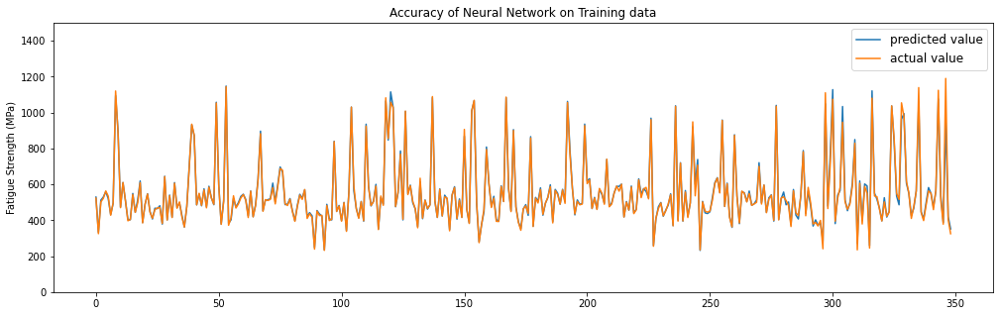

In [95]:
train_pred_2 = NN_model.predict(X_train)
plt.plot(range(349), train_pred_2)
plt.plot(range(349), y_train)
plt.ylim(0, 1500)
plt.ylabel('Fatigue Strength (MPa)')
L = plt.legend('upper right', prop={'size': 12})
L.get_texts()[0].set_text('predicted value')
L.get_texts()[1].set_text('actual value')
fig = plt.gcf()
fig.set_size_inches(17, 5)
plt.title('Accuracy of Neural Network on Training data')
plt.savefig('NNTrain.png')

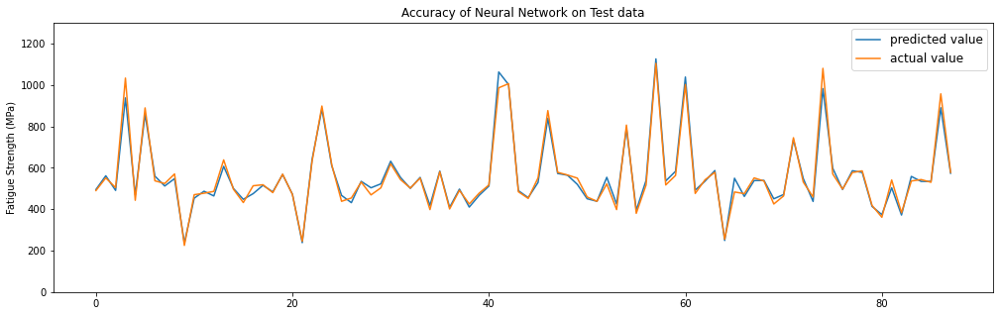

In [96]:
Y_pred_2 = NN_model.predict(X_test)
plt.plot(range(88), Y_pred_2)
plt.plot(range(88), y_test)
plt.ylim(0, 1300)
plt.ylabel('Fatigue Strength (MPa)')
L = plt.legend('upper right', prop={'size': 12})
L.get_texts()[0].set_text('predicted value')
L.get_texts()[1].set_text('actual value')
fig = plt.gcf()
fig.set_size_inches(17, 5)
plt.title('Accuracy of Neural Network on Test data')
plt.savefig('NNTest.png')
plt.show()

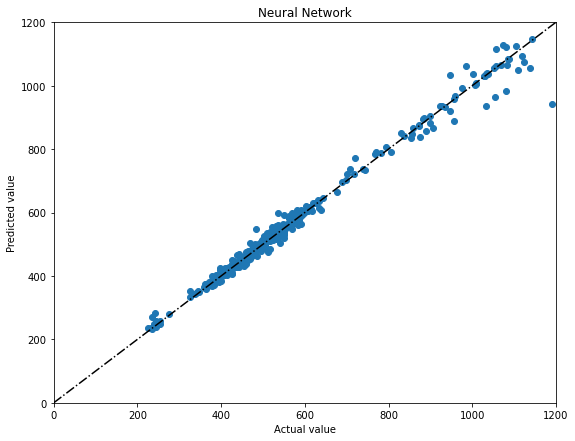

In [97]:
x = np.linspace(0, 1200, 1000)
plt.plot(x, x+0, '-.k')
plt.scatter(y, np.ravel(NN_model.predict(X)))
plt.title("Neural Network")
plt.xlabel("Actual value")
plt.ylabel("Predicted value")
fig = plt.gcf()
fig.set_size_inches(9, 7)
plt.xlim(0,1200)
plt.ylim(0,1200)
plt.savefig('NNScatter.png')

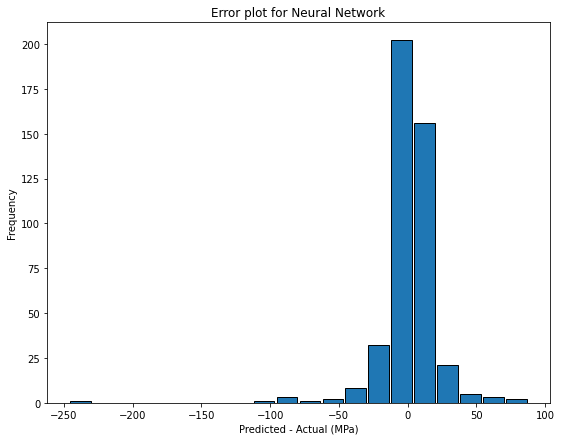

In [98]:
error_3 = np.ravel(NN_model.predict(X)) - y
plt.hist(error_3, edgecolor='black', linewidth = 1.0, rwidth = 0.9, bins=20)
plt.title("Error plot for Neural Network")
plt.xlabel("Predicted - Actual (MPa)")
plt.ylabel("Frequency")
fig = plt.gcf()
fig.set_size_inches(9, 7)
plt.savefig('NNError.png')

## RandomForestRegressor

The random forest model is a type of additive model that makes predictions by combining decisions from a sequence of base models. More formally we can write this class of models as:

                                        g(x)=f0(x)+f1(x)+f2(x)+...

where the final model g is the sum of simple base models fi. Here, each base classifier is a simple decision tree. This broad technique of using multiple models to obtain better predictive performance is called model ensembling. In random forests, all the base models are constructed independently using a different subsample of the data. The subsample size is always the same as the original input sample size but the samples are drawn with replacement if bootstrap=True

The random forest model is very good at handling tabular data with numerical features, or categorical features with fewer than hundreds of categories. Unlike linear models, random forests are able to capture non-linear interaction between the features and the target. When dealing with sparse input data (e.g. categorical features with large dimension), we can either pre-process the sparse features to generate numerical statistics, or switch to a linear model, which is better suited for such scenarios.

In [99]:
rfregr = RandomForestRegressor(n_estimators=100, n_jobs=-1, max_depth=12, verbose=False, random_state=1, oob_score=True)
rfregr.fit(X_train, y_train)
rfrtrain = r2_score(y_train, rfregr.predict(X_train))
print("Random Forest Train data:", rfrtrain)

Random Forest Train data: 0.9966417461560314


In [100]:
Y_pred_5 = rfregr.predict(X_test)
RFRerror = r2_score(y_test, Y_pred_5)
print("Random Forest Test data:", RFRerror)

Random Forest Test data: 0.9773824124918963


### Visualizing the predictions made by the Random Forest Regressor and comparing it with the actual data points present in the training and testing dataset.

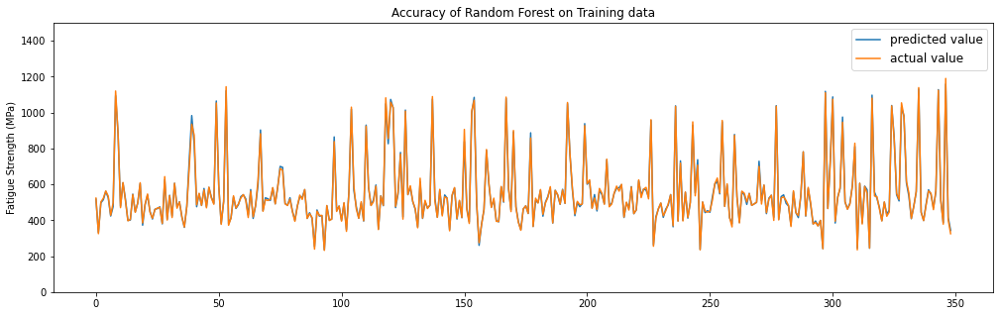

In [101]:
train_pred_5 = rfregr.predict(X_train)
plt.plot(range(349), train_pred_5)
plt.plot(range(349), y_train)
plt.ylim(0, 1500)
plt.ylabel('Fatigue Strength (MPa)')
L = plt.legend('upper right', prop={'size': 12})
L.get_texts()[0].set_text('predicted value')
L.get_texts()[1].set_text('actual value')
fig = plt.gcf()
fig.set_size_inches(17, 5)
plt.title('Accuracy of Random Forest on Training data')
plt.savefig('RFTrain.png')

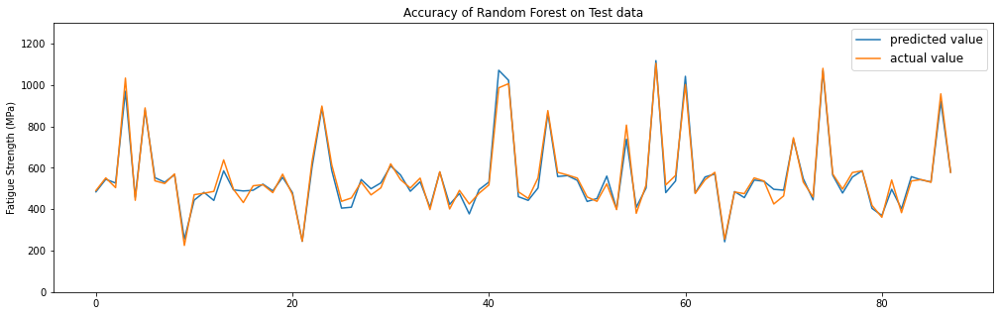

In [102]:
plt.figure(figsize=(15,5))
plt.plot(range(88), Y_pred_5)
plt.plot(range(88), y_test)
plt.ylim(0, 1300)
plt.ylabel('Fatigue Strength (MPa)')
L = plt.legend('upper right', prop={'size': 12})
L.get_texts()[0].set_text('predicted value')
L.get_texts()[1].set_text('actual value')
fig = plt.gcf()
fig.set_size_inches(17, 5)
plt.title('Accuracy of Random Forest on Test data')
plt.savefig('RFTest.png')
plt.show()

### Using the attribute 'feature_importances_' to rank the importance of each feature with respect to the target variable.

In [103]:
importance = rfregr.feature_importances_
std = np.std([tree.feature_importances_ for tree in rfregr.estimators_],
             axis=0)
indices = np.argsort(importance)[::-1]

print("Feature ranking:")

for f in range(X.shape[1]):
    print("%d. feature %d (%f)" % (f + 1, indices[f], importance[indices[f]]))

Feature ranking:
1. feature 8 (0.135624)
2. feature 5 (0.131602)
3. feature 18 (0.111351)
4. feature 0 (0.110931)
5. feature 10 (0.094775)
6. feature 4 (0.092891)
7. feature 6 (0.085074)
8. feature 7 (0.080353)
9. feature 9 (0.055611)
10. feature 12 (0.053999)
11. feature 15 (0.014861)
12. feature 14 (0.004941)
13. feature 22 (0.004875)
14. feature 13 (0.003905)
15. feature 21 (0.003253)
16. feature 2 (0.002896)
17. feature 20 (0.002413)
18. feature 11 (0.002207)
19. feature 1 (0.002135)
20. feature 16 (0.001643)
21. feature 19 (0.001430)
22. feature 3 (0.001391)
23. feature 17 (0.001138)
24. feature 24 (0.000444)
25. feature 23 (0.000255)


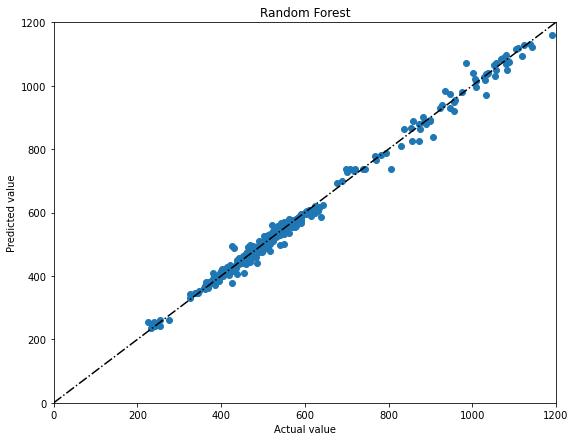

In [104]:
x = np.linspace(0, 1200, 1000)
plt.plot(x, x+0, '-.k')
plt.scatter(y, rfregr.predict(X))
plt.title("Random Forest")
plt.xlabel("Actual value")
plt.ylabel("Predicted value")
fig = plt.gcf()
fig.set_size_inches(9, 7)
plt.xlim(0,1200)
plt.ylim(0,1200)
plt.savefig('RFScatter.png')

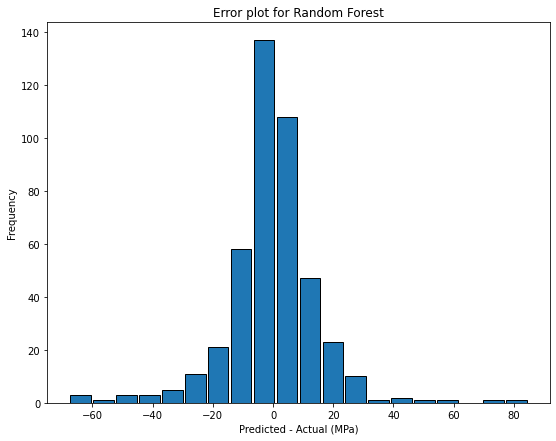

In [105]:
error_4 = rfregr.predict(X) - y
plt.hist(error_4, edgecolor='black', linewidth = 1.0, rwidth = 0.9, bins=20)
plt.title("Error plot for Random Forest")
plt.xlabel("Predicted - Actual (MPa)")
plt.ylabel("Frequency")
fig = plt.gcf()
fig.set_size_inches(9, 7)
plt.savefig('RFError.png')

## Gradient Boost Regressor

Gradient boosting is a machine learning technique for regression and classification problems, which produces a prediction model in the form of an ensemble of weak prediction models, typically decision trees. The objective of any supervised learning algorithm is to define a loss function and minimize it. Gradient Boosting allows for the optimization of arbitrary differentiable loss functions. In each stage a regression tree is fit on the negative gradient of the given loss function.

In [106]:
from sklearn.ensemble import GradientBoostingRegressor
gbregr = GradientBoostingRegressor(n_estimators=100, max_depth=6, verbose=True, random_state=1)
gbregr.fit(X_train, y_train)
gbrtrain = r2_score(y_train, gbregr.predict(X_train))
print("Random Forest Train data:", gbrtrain)

      Iter       Train Loss   Remaining Time 
         1       28977.1649            0.26s
         2       23555.3854            0.25s
         3       19160.8347            0.23s
         4       15592.9730            0.26s
         5       12702.6984            0.23s
         6       10360.6698            0.22s
         7        8457.8801            0.22s
         8        6908.6553            0.21s
         9        5644.6246            0.20s
        10        4617.9809            0.20s
        20         716.9405            0.18s
        30         175.5942            0.15s
        40          68.4614            0.14s
        50          35.9026            0.11s
        60          17.9462            0.08s
        70          12.7482            0.06s
        80          10.4450            0.04s
        90           8.3937            0.02s
       100           7.0558            0.00s
Random Forest Train data: 0.9998021779046163


In [107]:
Y_pred_6 = gbregr.predict(X_test)
GBRerror = r2_score(y_test, Y_pred_6)
print("Random Forest Test data:", GBRerror)

Random Forest Test data: 0.9791621903453103


### Visualizing the predictions made by the Gradient Boosting Regressor and comparing it with the actual data points present in the training and testing dataset.

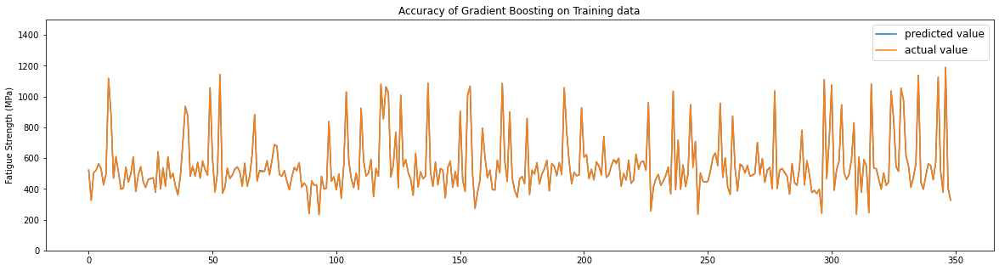

In [108]:
train_pred_6 = gbregr.predict(X_train)
plt.plot(range(349), train_pred_6)
plt.plot(range(349), y_train)
plt.ylim(0, 1500)
plt.ylabel('Fatigue Strength (MPa)')
L = plt.legend('upper right', prop={'size': 12})
L.get_texts()[0].set_text('predicted value')
L.get_texts()[1].set_text('actual value')
fig = plt.gcf()
fig.set_size_inches(20, 5)
plt.title('Accuracy of Gradient Boosting on Training data')
plt.savefig('GBTrain.png')

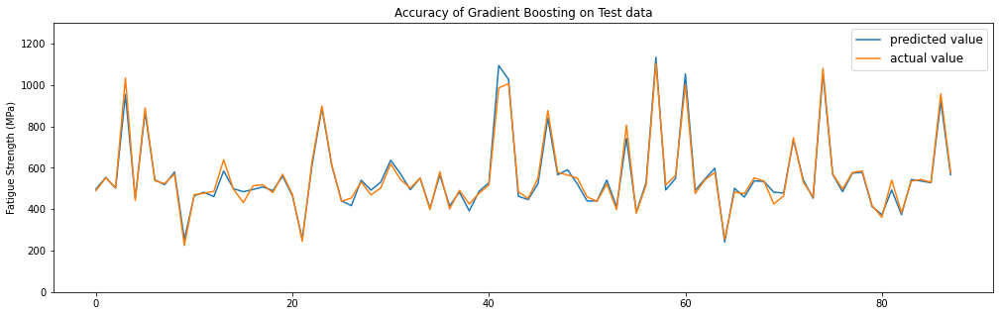

In [109]:
plt.plot(range(88), Y_pred_6)
plt.plot(range(88), y_test)
plt.ylim(0, 1300)
plt.ylabel('Fatigue Strength (MPa)')
L = plt.legend('upper right', prop={'size': 12})
L.get_texts()[0].set_text('predicted value')
L.get_texts()[1].set_text('actual value')
fig = plt.gcf()
fig.set_size_inches(17, 5)
plt.title('Accuracy of Gradient Boosting on Test data')
plt.savefig('GBTest.png')
plt.show()

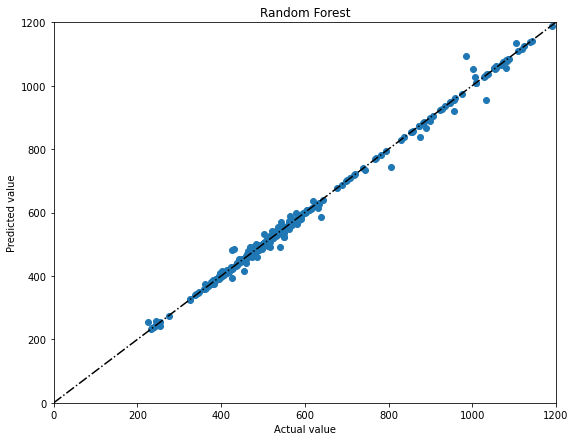

In [110]:
x = np.linspace(0, 1200, 1000)
plt.plot(x, x+0, '-.k')
plt.scatter(y, gbregr.predict(X))
plt.title("Random Forest")
plt.xlabel("Actual value")
plt.ylabel("Predicted value")
fig = plt.gcf()
fig.set_size_inches(9, 7)
plt.xlim(0,1200)
plt.ylim(0,1200)
plt.savefig('GBScatter.png')

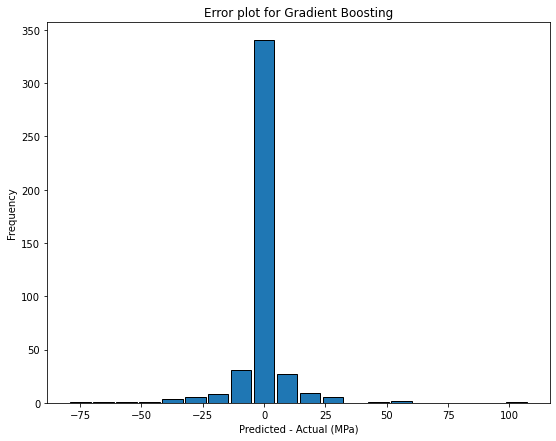

In [111]:
error_5 = gbregr.predict(X) - y
plt.hist(error_5, edgecolor='black', linewidth = 1.0, rwidth = 0.9, bins=20)
plt.title("Error plot for Gradient Boosting")
plt.xlabel("Predicted - Actual (MPa)")
plt.ylabel("Frequency")
fig = plt.gcf()
fig.set_size_inches(9, 7)
plt.savefig('GBError.png')

## ADA Boost regressor

An AdaBoost regressor is a meta-estimator that begins by fitting a regressor on the original dataset and then fits additional copies of the regressor on the same dataset but where the weights of instances are adjusted according to the error of the current prediction. As such, subsequent regressors focus more on difficult cases.

AdaBoost can be used to boost the performance of any machine learning algorithm. These are models that achieve accuracy just above random chance on a classification problem. The most suited and therefore most common algorithm used with AdaBoost are decision trees with one level. Because these trees are so short and only contain one decision for classification, they are often called decision stumps.

In [112]:
from sklearn.ensemble import AdaBoostRegressor
adaregr = AdaBoostRegressor(n_estimators=100, learning_rate=0.9, random_state=1)
adaregr.fit(X_train, y_train)
adartrain = r2_score(y_train, adaregr.predict(X_train))
print("Random Forest Train data:", adartrain)

Random Forest Train data: 0.9742539041226835


In [113]:
Y_pred_7 = adaregr.predict(X_test)
adaRerror = r2_score(y_test, Y_pred_7)
print("Random Forest Test data:", adaRerror)

Random Forest Test data: 0.9745006539109746


### Visualizing the predictions made by the ADA Boost Regressor and comparing it with the actual data points present in the training and testing dataset.

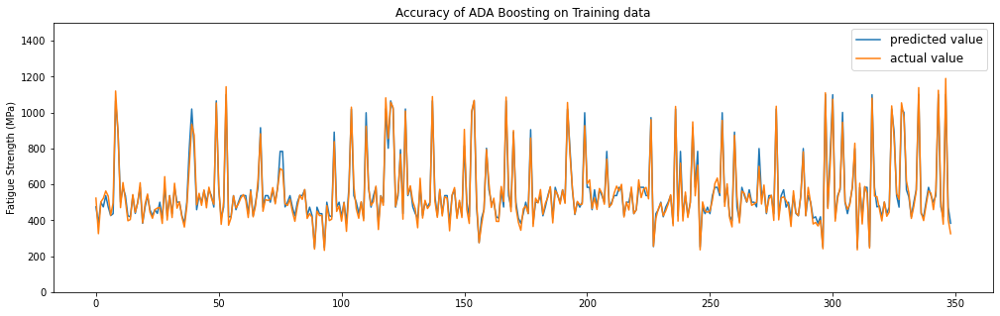

In [114]:
train_pred_7 = adaregr.predict(X_train)
plt.plot(range(349), train_pred_7)
plt.plot(range(349), y_train)
plt.ylim(0, 1500)
plt.ylabel('Fatigue Strength (MPa)')
L = plt.legend('upper right', prop={'size': 12})
L.get_texts()[0].set_text('predicted value')
L.get_texts()[1].set_text('actual value')
fig = plt.gcf()
fig.set_size_inches(17, 5)
plt.title('Accuracy of ADA Boosting on Training data')
plt.savefig('ADATrain.png')

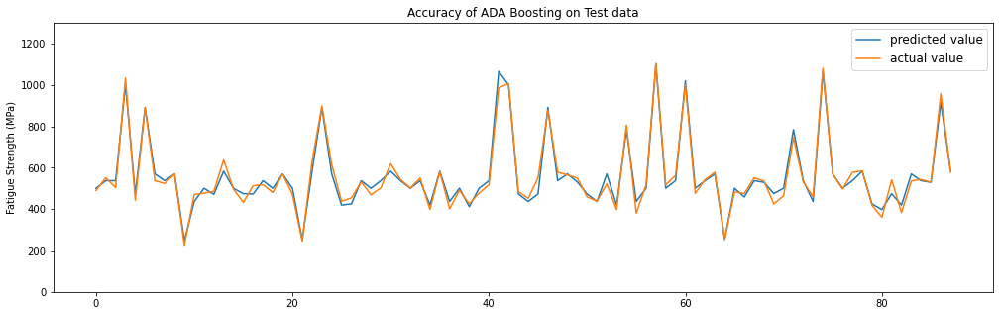

In [115]:
plt.plot(range(88), Y_pred_7)
plt.plot(range(88), y_test)
plt.ylim(0, 1300)
plt.ylabel('Fatigue Strength (MPa)')
L = plt.legend('upper right', prop={'size': 12})
L.get_texts()[0].set_text('predicted value')
L.get_texts()[1].set_text('actual value')
fig = plt.gcf()
fig.set_size_inches(17, 5)
plt.title('Accuracy of ADA Boosting on Test data')
plt.savefig('ADATest.png')
plt.show()

In [116]:
importance_1 = adaregr.feature_importances_
std_1 = np.std([tree.feature_importances_ for tree in adaregr.estimators_],
             axis=0)
indices_1 = np.argsort(importance_1)[::-1]

print("Feature ranking:")

for f in range(independent_features.shape[1]):
    print("%d. feature %d (%f)" % (f + 1, indices_1[f], importance_1[indices_1[f]]))

Feature ranking:
1. feature 9 (0.385663)
2. feature 18 (0.109983)
3. feature 10 (0.109362)
4. feature 7 (0.067795)
5. feature 5 (0.067307)
6. feature 8 (0.063852)
7. feature 0 (0.063141)
8. feature 12 (0.037009)
9. feature 6 (0.024173)
10. feature 20 (0.014041)
11. feature 22 (0.009711)
12. feature 17 (0.008896)
13. feature 15 (0.006007)
14. feature 11 (0.005417)
15. feature 13 (0.005349)
16. feature 16 (0.004675)
17. feature 2 (0.004504)
18. feature 3 (0.004372)
19. feature 1 (0.004109)
20. feature 14 (0.002612)
21. feature 21 (0.002023)
22. feature 19 (0.000000)
23. feature 23 (0.000000)
24. feature 4 (0.000000)
25. feature 24 (0.000000)


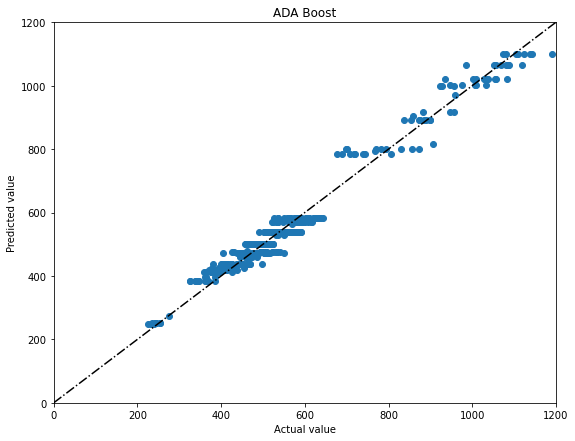

In [117]:
x = np.linspace(0, 1200, 1000)
plt.plot(x, x+0, '-.k')
plt.scatter(y, adaregr.predict(X))
plt.title("ADA Boost")
plt.xlabel("Actual value")
plt.ylabel("Predicted value")
fig = plt.gcf()
fig.set_size_inches(9, 7)
plt.xlim(0,1200)
plt.ylim(0,1200)
plt.savefig('ADAScatter.png')

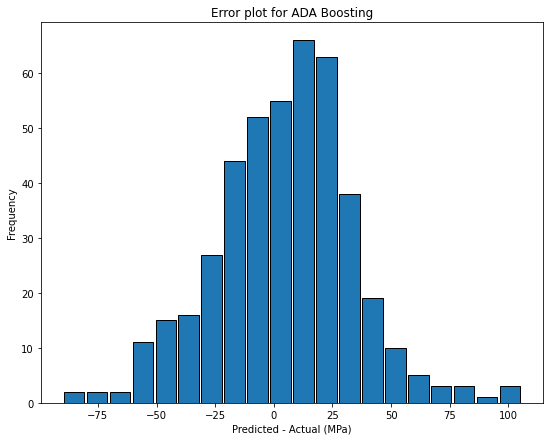

In [118]:
error_6 = adaregr.predict(X) - y
plt.hist(error_6, edgecolor='black', linewidth = 1.0, rwidth = 0.9, bins=20)
plt.title("Error plot for ADA Boosting")
plt.xlabel("Predicted - Actual (MPa)")
plt.ylabel("Frequency")
fig = plt.gcf()
fig.set_size_inches(9, 7)
plt.savefig('ADAError.png')

## LightGBM

LightGBM is a gradient boosting framework that uses tree based learning algorithms. It is designed to be distributed and efficient with faster training speed and higher efficiency, lower memory usage and better accuracy. It is based on decision tree algorithms and is used for ranking, classification, regression and many more maching learning tasks. 
    
 Light GBM grows tree vertically while other algorithm grows trees horizontally meaning that Light GBM grows tree leaf-wise while other algorithm grows level-wise. It will choose the leaf with max delta loss to grow. When growing the same leaf, Leaf-wise algorithm can reduce more loss than a level-wise algorithm.

In [119]:
import lightgbm as lgb
import warnings
warnings.filterwarnings("ignore", message="No further splits with positive gain")
lgbmregr = lgb.LGBMRegressor(n_jobs=-1, subsample=1.0, learning_rate=0.5, min_split_gain=.01)
lgbmregr.fit(X_train, y_train)
lgbmrtrain = r2_score(y_train, lgbmregr.predict(X_train))
print("Light GBM Train data:", lgbmrtrain)

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001283 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 414
[LightGBM] [Info] Number of data points in the train set: 349, number of used features: 25
[LightGBM] [Info] Start training from score 551.819484
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: 

In [120]:
lgbmrtrain = r2_score(y_train, lgbmregr.predict(X_train))
print("Light GBM Train data:", lgbmrtrain)
Y_pred_8 = lgbmregr.predict(X_test)
lgbmRerror = r2_score(y_test, Y_pred_8)
print("Light GBM Test data:", lgbmRerror)

Light GBM Train data: 0.9975067273577455
Light GBM Test data: 0.9847312886389342


### Visualizing the predictions made by the LightGBM Regressor and comparing it with the actual data points present in the training and testing dataset.

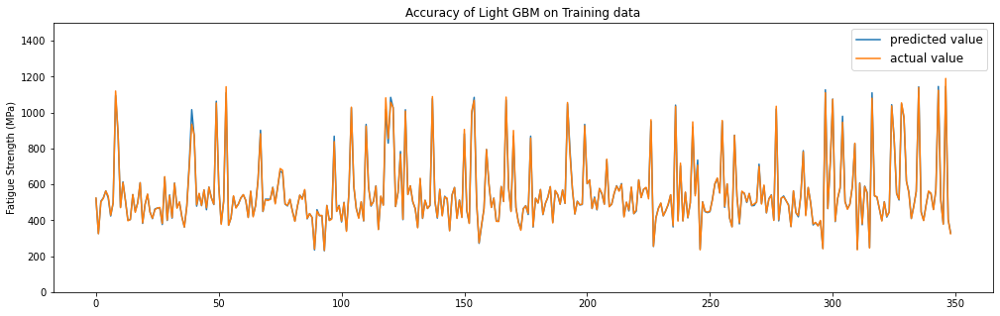

In [121]:
train_pred_8 = lgbmregr.predict(X_train)
plt.figure(figsize=(25,5))
plt.plot(range(349), train_pred_8)
plt.plot(range(349), y_train)
plt.ylim(0, 1500)
plt.ylabel('Fatigue Strength (MPa)')
L = plt.legend('upper right', prop={'size': 12})
L.get_texts()[0].set_text('predicted value')
L.get_texts()[1].set_text('actual value')
fig = plt.gcf()
fig.set_size_inches(17, 5)
plt.title('Accuracy of Light GBM on Training data')
plt.savefig('LGBMTrain.png')

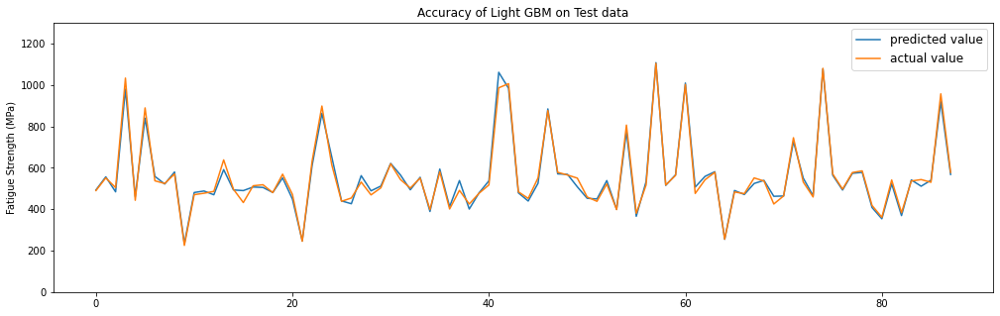

In [122]:
plt.figure(figsize=(15,5))
plt.plot(range(88), Y_pred_8)
plt.plot(range(88), y_test)
plt.ylim(0, 1300)
plt.ylabel('Fatigue Strength (MPa)')
L = plt.legend('upper right', prop={'size': 12})
L.get_texts()[0].set_text('predicted value')
L.get_texts()[1].set_text('actual value')
fig = plt.gcf()
fig.set_size_inches(17, 5)
plt.title('Accuracy of Light GBM on Test data')
plt.savefig('LGBMTest.png')
plt.show()

### Using the attribute 'feature_importances_' to rank the importance of each feature with respect to the target variable.

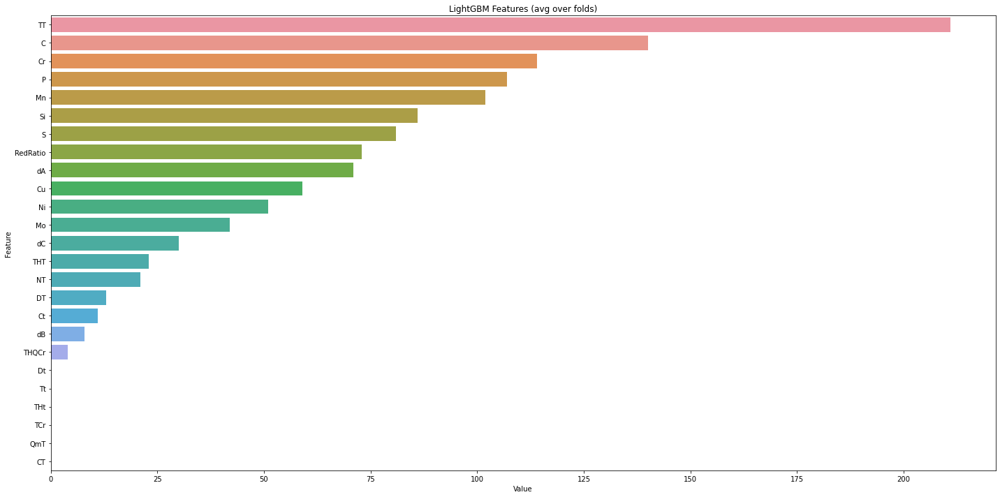

<Figure size 432x288 with 0 Axes>

In [123]:
import seaborn as sns

# sorted(zip(clf.feature_importances_, X.columns), reverse=True)
feature_imp = pd.DataFrame(sorted(zip(lgbmregr.feature_importances_,independent_features.columns)), columns=['Value','Feature'])

plt.figure(figsize=(20, 10))
sns.barplot(x="Value", y="Feature", data=feature_imp.sort_values(by="Value", ascending=False))
plt.title('LightGBM Features (avg over folds)')
plt.tight_layout()
plt.show()
plt.savefig('lgbm_importances-01.png')

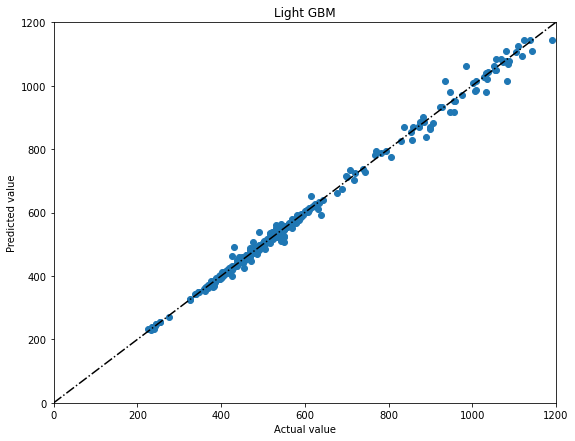

In [124]:
x = np.linspace(0, 1200, 1000)
plt.plot(x, x+0, '-.k')
plt.scatter(y, lgbmregr.predict(X))
plt.title("Light GBM")
plt.xlabel("Actual value")
plt.ylabel("Predicted value")
fig = plt.gcf()
fig.set_size_inches(9, 7)
plt.xlim(0,1200)
plt.ylim(0,1200)
plt.savefig('LGBMScatter.png')

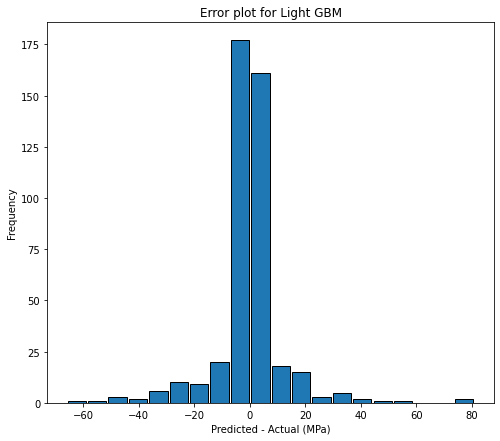

In [125]:
error_7 = lgbmregr.predict(X) - y
plt.hist(error_7, edgecolor='black', linewidth = 1.0, rwidth = 0.9, bins=20)
plt.title("Error plot for Light GBM")
plt.xlabel("Predicted - Actual (MPa)")
plt.ylabel("Frequency")
fig = plt.gcf()
fig.set_size_inches(8, 7)
plt.savefig('LGBMError.png')

## XGBoost Regressor

XGBoost stands for “Extreme Gradient Boosting”, where the term “Gradient Boosting” originates from the paper Greedy Function Approximation: A Gradient Boosting Machine, by Friedman. XGBoost is an optimized distributed gradient boosting library designed to be highly efficient, flexible and portable. It implements machine learning algorithms under the Gradient Boosting framework. XGBoost provides a parallel tree boosting (also known as GBDT, GBM) that solve many data science problems in a fast and accurate way. The same code runs on major distributed environment (Hadoop, SGE, MPI) and can solve problems beyond billions of examples.

In [126]:
xgbregr = xgb.XGBRegressor(n_estimators=100, learning_rate=0.2, max_depth=4)
xgbregr.fit(X_train, y_train)
XGBtrain = r2_score(y_train, xgbregr.predict(X_train))
print("XGBoost Regressor Train data:", XGBtrain)

XGBoost Regressor Train data: 0.998712662414656


In [127]:
Y_pred_9 = xgbregr.predict(X_test)
XGBerror = r2_score(y_test, Y_pred_9)
print("XGBoost Regressor Test data:", XGBerror)

XGBoost Regressor Test data: 0.9815299243374292


### Visualizing the predictions made by the XGBoost Regressor and comparing it with the actual data points present in the training and testing dataset.

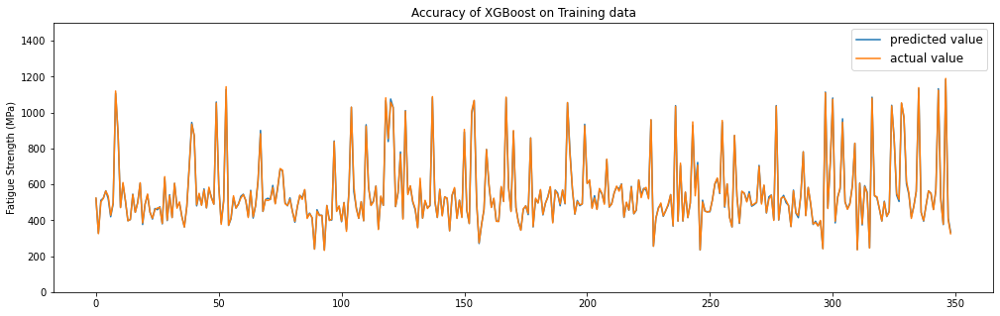

In [128]:
train_pred_9 = xgbregr.predict(X_train)
plt.plot(range(349), train_pred_9)
plt.plot(range(349), y_train)
plt.ylim(0, 1500)
plt.ylabel('Fatigue Strength (MPa)')
L = plt.legend('upper right', prop={'size': 12})
L.get_texts()[0].set_text('predicted value')
L.get_texts()[1].set_text('actual value')
fig = plt.gcf()
fig.set_size_inches(17, 5)
plt.title('Accuracy of XGBoost on Training data')
plt.savefig('XGBTrain.png')

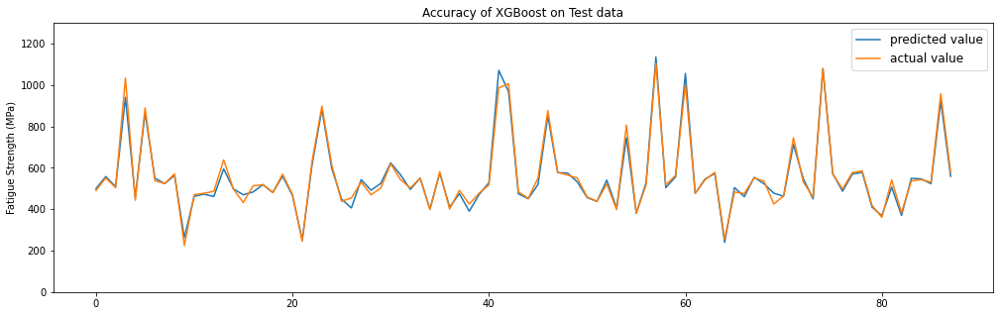

In [129]:
plt.plot(range(88), Y_pred_9)
plt.plot(range(88), y_test)
plt.ylim(0, 1300)
plt.ylabel('Fatigue Strength (MPa)')
L = plt.legend('upper right', prop={'size': 12})
L.get_texts()[0].set_text('predicted value')
L.get_texts()[1].set_text('actual value')
fig = plt.gcf()
fig.set_size_inches(17, 5)
plt.title('Accuracy of XGBoost on Test data')
plt.savefig('XGBTest.png')
plt.show()

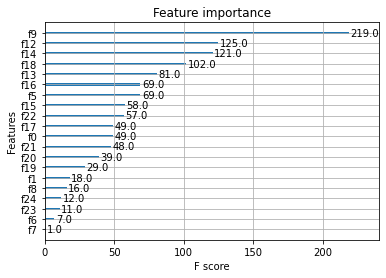

In [130]:
from xgboost import plot_importance
plot_importance(xgbregr)
plt.show()

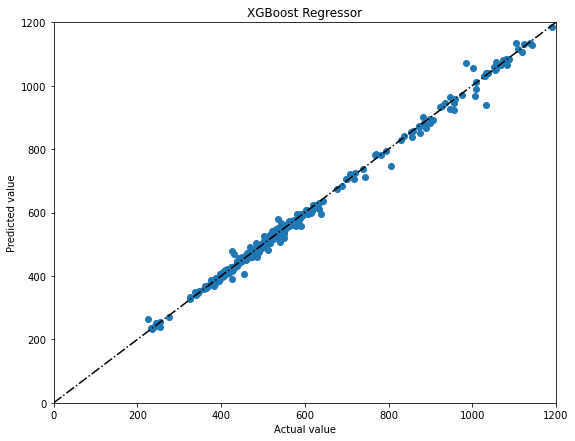

In [131]:
x = np.linspace(0, 1200, 1000)
plt.plot(x, x+0, '-.k')
plt.scatter(y, xgbregr.predict(X))
plt.title("XGBoost Regressor")
plt.xlabel("Actual value")
plt.ylabel("Predicted value")
fig = plt.gcf()
fig.set_size_inches(9, 7)
plt.xlim(0,1200)
plt.ylim(0,1200)
plt.savefig('XGBScatter.png')

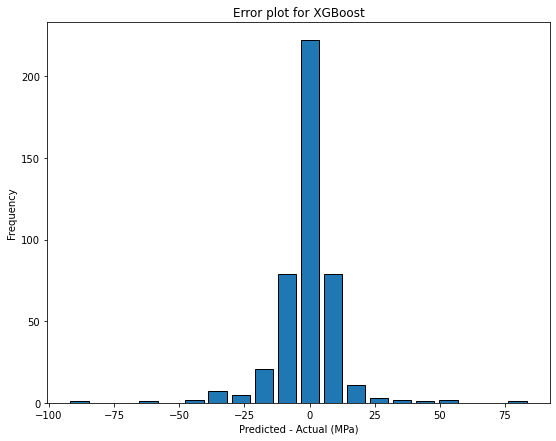

In [132]:
error_8 = xgbregr.predict(X) - y
plt.hist(error_8, edgecolor='black', linewidth = 1.0, rwidth = 0.8, bins=20)
plt.title("Error plot for XGBoost")
plt.xlabel("Predicted - Actual (MPa)")
plt.ylabel("Frequency")
fig = plt.gcf()
fig.set_size_inches(9, 7)
plt.savefig('XGBError.png')

## Creating an ensemble model to be used in fatigue prediction

The ensemble is trained on the top five features from the 25 features dataset and makes its predictions.

The top five features are:

1.Tempering Temperature
    
2.Carbon
    
3.Chromium

4.Manganese

5.Phosphorous
    
These five features have been chosen by the machine learning models and are backed by material science theory. Refer to the Thesis for more information regarding this.

The ensemble consists of the following models:

1.Neural Network

2.Decision Tree regressor

3.XGBoost regressor

4.LightGBM regressor

5.ADA Boost regressor

In [133]:
features = ['TT', 'C', 'Cr', 'Mn', 'P']
X_final = data[features]
y_final = data[target]
sc = StandardScaler()
X = sc.fit_transform(X)
Xtrain, Xtest, ytrain, ytest = train_test_split(X_final, y_final, test_size=0.2, random_state=1)

## Neural Network

In [134]:
NN_model1 = Sequential()

# The Input Layer :
NN_model1.add(Dense(512, kernel_initializer='normal',input_dim = 5, activation='relu'))

# The Hidden Layers :
NN_model1.add(Dense(256, kernel_initializer='normal',activation='relu'))
NN_model1.add(Dense(128, kernel_initializer='normal',activation='relu'))
NN_model1.add(Dense(64, kernel_initializer='normal',activation='relu'))

# The Output Layer :
NN_model1.add(Dense(1, kernel_initializer='normal',activation='linear'))

# Compile the network :
NN_model1.compile(loss='mean_absolute_error', optimizer='adam', metrics=['mean_absolute_error'])
NN_model1.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_5 (Dense)             (None, 512)               3072      
                                                                 
 dense_6 (Dense)             (None, 256)               131328    
                                                                 
 dense_7 (Dense)             (None, 128)               32896     
                                                                 
 dense_8 (Dense)             (None, 64)                8256      
                                                                 
 dense_9 (Dense)             (None, 1)                 65        
                                                                 
Total params: 175,617
Trainable params: 175,617
Non-trainable params: 0
_________________________________________________________________


In [135]:
import statistics
NN_model1.fit(Xtrain, ytrain, epochs=400, validation_split = 0.2, callbacks=callbacks_list)
dtregr.fit(Xtrain, ytrain)
xgbregr.fit(Xtrain, ytrain)
lgbmregr.fit(Xtrain, ytrain)
adaregr.fit(Xtrain, ytrain)

pred1 = np.ravel(NN_model1.predict(Xtest))
pred2 = np.array(dtregr.predict(Xtest))
pred3 = np.array(xgbregr.predict(Xtest))
pred4 = np.array(lgbmregr.predict(Xtest))
pred5 = np.array(adaregr.predict(Xtest))

final_pred = np.mean(np.array([pred1, pred2, pred3, pred4, pred5]), axis=0)
print(r2_score(final_pred, y_test))

Epoch 1/400
1/9 [==>...........................] - ETA: 5s - loss: 528.2428 - mean_absolute_error: 528.2428
Epoch 00001: val_loss did not improve from 20.99814
9/9 [==============================] - 1s 40ms/step - loss: 523.9374 - mean_absolute_error: 523.9373 - val_loss: 504.2178 - val_mean_absolute_error: 504.2178
Epoch 2/400
1/9 [==>...........................] - ETA: 0s - loss: 476.0967 - mean_absolute_error: 476.0967
Epoch 00002: val_loss did not improve from 20.99814
9/9 [==============================] - 0s 11ms/step - loss: 350.3640 - mean_absolute_error: 350.3640 - val_loss: 234.5775 - val_mean_absolute_error: 234.5775
Epoch 3/400
1/9 [==>...........................] - ETA: 0s - loss: 174.6393 - mean_absolute_error: 174.6393
Epoch 00003: val_loss did not improve from 20.99814
9/9 [==============================] - 0s 10ms/step - loss: 199.7898 - mean_absolute_error: 199.7898 - val_loss: 235.9354 - val_mean_absolute_error: 235.9354
Epoch 4/400
1/9 [==>..........................

Epoch 27/400
1/9 [==>...........................] - ETA: 0s - loss: 123.9177 - mean_absolute_error: 123.9177
Epoch 00027: val_loss did not improve from 20.99814
9/9 [==============================] - 0s 10ms/step - loss: 166.8140 - mean_absolute_error: 166.8140 - val_loss: 232.5726 - val_mean_absolute_error: 232.5726
Epoch 28/400
1/9 [==>...........................] - ETA: 0s - loss: 142.6663 - mean_absolute_error: 142.6663
Epoch 00028: val_loss did not improve from 20.99814
9/9 [==============================] - 0s 8ms/step - loss: 168.4173 - mean_absolute_error: 168.4173 - val_loss: 232.2593 - val_mean_absolute_error: 232.2593
Epoch 29/400
1/9 [==>...........................] - ETA: 0s - loss: 146.1306 - mean_absolute_error: 146.1306
Epoch 00029: val_loss did not improve from 20.99814
9/9 [==============================] - 0s 10ms/step - loss: 167.1336 - mean_absolute_error: 167.1336 - val_loss: 232.6198 - val_mean_absolute_error: 232.6198
Epoch 30/400
1/9 [==>.......................

Epoch 53/400
1/9 [==>...........................] - ETA: 0s - loss: 146.9767 - mean_absolute_error: 146.9767
Epoch 00053: val_loss did not improve from 20.99814
9/9 [==============================] - 0s 9ms/step - loss: 167.2739 - mean_absolute_error: 167.2739 - val_loss: 230.7189 - val_mean_absolute_error: 230.7189
Epoch 54/400
1/9 [==>...........................] - ETA: 0s - loss: 140.7318 - mean_absolute_error: 140.7318
Epoch 00054: val_loss did not improve from 20.99814
9/9 [==============================] - 0s 10ms/step - loss: 165.8289 - mean_absolute_error: 165.8289 - val_loss: 230.6061 - val_mean_absolute_error: 230.6061
Epoch 55/400
1/9 [==>...........................] - ETA: 0s - loss: 156.1041 - mean_absolute_error: 156.1041
Epoch 00055: val_loss did not improve from 20.99814
9/9 [==============================] - 0s 8ms/step - loss: 166.3770 - mean_absolute_error: 166.3770 - val_loss: 230.5186 - val_mean_absolute_error: 230.5186
Epoch 56/400
1/9 [==>........................

Epoch 79/400
1/9 [==>...........................] - ETA: 0s - loss: 130.3433 - mean_absolute_error: 130.3433
Epoch 00079: val_loss did not improve from 20.99814
9/9 [==============================] - 0s 7ms/step - loss: 164.0891 - mean_absolute_error: 164.0891 - val_loss: 227.3737 - val_mean_absolute_error: 227.3737
Epoch 80/400
1/9 [==>...........................] - ETA: 0s - loss: 222.8929 - mean_absolute_error: 222.8929
Epoch 00080: val_loss did not improve from 20.99814
9/9 [==============================] - 0s 7ms/step - loss: 164.0129 - mean_absolute_error: 164.0129 - val_loss: 227.0894 - val_mean_absolute_error: 227.0894
Epoch 81/400
1/9 [==>...........................] - ETA: 0s - loss: 114.5674 - mean_absolute_error: 114.5674
Epoch 00081: val_loss did not improve from 20.99814
9/9 [==============================] - 0s 7ms/step - loss: 166.4330 - mean_absolute_error: 166.4330 - val_loss: 230.9348 - val_mean_absolute_error: 230.9348
Epoch 82/400
1/9 [==>.........................

Epoch 105/400
1/9 [==>...........................] - ETA: 0s - loss: 116.1848 - mean_absolute_error: 116.1848
Epoch 00105: val_loss did not improve from 20.99814
9/9 [==============================] - 0s 8ms/step - loss: 155.9126 - mean_absolute_error: 155.9126 - val_loss: 214.0052 - val_mean_absolute_error: 214.0052
Epoch 106/400
1/9 [==>...........................] - ETA: 0s - loss: 164.1197 - mean_absolute_error: 164.1197
Epoch 00106: val_loss did not improve from 20.99814
9/9 [==============================] - 0s 7ms/step - loss: 155.5762 - mean_absolute_error: 155.5762 - val_loss: 212.5572 - val_mean_absolute_error: 212.5572
Epoch 107/400
1/9 [==>...........................] - ETA: 0s - loss: 132.7057 - mean_absolute_error: 132.7057
Epoch 00107: val_loss did not improve from 20.99814
9/9 [==============================] - 0s 7ms/step - loss: 155.2964 - mean_absolute_error: 155.2964 - val_loss: 212.6016 - val_mean_absolute_error: 212.6016
Epoch 108/400
1/9 [==>.....................

Epoch 131/400
1/9 [==>...........................] - ETA: 0s - loss: 96.7697 - mean_absolute_error: 96.7697
Epoch 00131: val_loss did not improve from 20.99814
9/9 [==============================] - 0s 11ms/step - loss: 99.0947 - mean_absolute_error: 99.0947 - val_loss: 141.0441 - val_mean_absolute_error: 141.0441
Epoch 132/400
1/9 [==>...........................] - ETA: 0s - loss: 110.1172 - mean_absolute_error: 110.1172
Epoch 00132: val_loss did not improve from 20.99814
9/9 [==============================] - 0s 12ms/step - loss: 93.4622 - mean_absolute_error: 93.4622 - val_loss: 127.7354 - val_mean_absolute_error: 127.7354
Epoch 133/400
1/9 [==>...........................] - ETA: 0s - loss: 99.2427 - mean_absolute_error: 99.2427
Epoch 00133: val_loss did not improve from 20.99814
9/9 [==============================] - 0s 12ms/step - loss: 85.3344 - mean_absolute_error: 85.3344 - val_loss: 137.1772 - val_mean_absolute_error: 137.1772
Epoch 134/400
1/9 [==>...........................]

Epoch 157/400
1/9 [==>...........................] - ETA: 0s - loss: 81.4474 - mean_absolute_error: 81.4474
Epoch 00157: val_loss did not improve from 20.99814
9/9 [==============================] - 0s 7ms/step - loss: 82.9212 - mean_absolute_error: 82.9212 - val_loss: 116.6913 - val_mean_absolute_error: 116.6913
Epoch 158/400
1/9 [==>...........................] - ETA: 0s - loss: 109.5596 - mean_absolute_error: 109.5596
Epoch 00158: val_loss did not improve from 20.99814
9/9 [==============================] - 0s 7ms/step - loss: 78.9354 - mean_absolute_error: 78.9354 - val_loss: 114.1348 - val_mean_absolute_error: 114.1348
Epoch 159/400
1/9 [==>...........................] - ETA: 0s - loss: 122.8971 - mean_absolute_error: 122.8971
Epoch 00159: val_loss did not improve from 20.99814
9/9 [==============================] - 0s 9ms/step - loss: 78.0297 - mean_absolute_error: 78.0297 - val_loss: 111.6958 - val_mean_absolute_error: 111.6958
Epoch 160/400
1/9 [==>...........................] 

Epoch 183/400
1/9 [==>...........................] - ETA: 0s - loss: 71.8189 - mean_absolute_error: 71.8189
Epoch 00183: val_loss did not improve from 20.99814
9/9 [==============================] - 0s 7ms/step - loss: 73.5491 - mean_absolute_error: 73.5491 - val_loss: 111.7096 - val_mean_absolute_error: 111.7096
Epoch 184/400
1/9 [==>...........................] - ETA: 0s - loss: 61.9763 - mean_absolute_error: 61.9763
Epoch 00184: val_loss did not improve from 20.99814
9/9 [==============================] - 0s 7ms/step - loss: 74.4971 - mean_absolute_error: 74.4971 - val_loss: 117.8346 - val_mean_absolute_error: 117.8346
Epoch 185/400
1/9 [==>...........................] - ETA: 0s - loss: 80.2623 - mean_absolute_error: 80.2623
Epoch 00185: val_loss did not improve from 20.99814
9/9 [==============================] - 0s 7ms/step - loss: 74.8602 - mean_absolute_error: 74.8602 - val_loss: 110.3308 - val_mean_absolute_error: 110.3308
Epoch 186/400
1/9 [==>...........................] - ET

1/9 [==>...........................] - ETA: 0s - loss: 56.7709 - mean_absolute_error: 56.7709
Epoch 00209: val_loss did not improve from 20.99814
9/9 [==============================] - 0s 7ms/step - loss: 75.9307 - mean_absolute_error: 75.9307 - val_loss: 109.2456 - val_mean_absolute_error: 109.2456
Epoch 210/400
1/9 [==>...........................] - ETA: 0s - loss: 82.5655 - mean_absolute_error: 82.5655
Epoch 00210: val_loss did not improve from 20.99814
9/9 [==============================] - 0s 7ms/step - loss: 74.9858 - mean_absolute_error: 74.9858 - val_loss: 121.9006 - val_mean_absolute_error: 121.9006
Epoch 211/400
1/9 [==>...........................] - ETA: 0s - loss: 91.0787 - mean_absolute_error: 91.0787
Epoch 00211: val_loss did not improve from 20.99814
9/9 [==============================] - 0s 7ms/step - loss: 79.7250 - mean_absolute_error: 79.7250 - val_loss: 112.7825 - val_mean_absolute_error: 112.7825
Epoch 212/400
1/9 [==>...........................] - ETA: 0s - loss: 

1/9 [==>...........................] - ETA: 0s - loss: 92.0688 - mean_absolute_error: 92.0688
Epoch 00235: val_loss did not improve from 20.99814
9/9 [==============================] - 0s 7ms/step - loss: 75.9653 - mean_absolute_error: 75.9653 - val_loss: 116.6917 - val_mean_absolute_error: 116.6917
Epoch 236/400
1/9 [==>...........................] - ETA: 0s - loss: 84.7949 - mean_absolute_error: 84.7949
Epoch 00236: val_loss did not improve from 20.99814
9/9 [==============================] - 0s 8ms/step - loss: 73.0826 - mean_absolute_error: 73.0826 - val_loss: 108.3352 - val_mean_absolute_error: 108.3352
Epoch 237/400
1/9 [==>...........................] - ETA: 0s - loss: 83.5764 - mean_absolute_error: 83.5764
Epoch 00237: val_loss did not improve from 20.99814
9/9 [==============================] - 0s 9ms/step - loss: 72.2918 - mean_absolute_error: 72.2918 - val_loss: 107.3894 - val_mean_absolute_error: 107.3894
Epoch 238/400
1/9 [==>...........................] - ETA: 0s - loss: 

1/9 [==>...........................] - ETA: 0s - loss: 71.2782 - mean_absolute_error: 71.2782
Epoch 00261: val_loss did not improve from 20.99814
9/9 [==============================] - 0s 8ms/step - loss: 70.8042 - mean_absolute_error: 70.8042 - val_loss: 109.3477 - val_mean_absolute_error: 109.3477
Epoch 262/400
1/9 [==>...........................] - ETA: 0s - loss: 55.5395 - mean_absolute_error: 55.5395
Epoch 00262: val_loss did not improve from 20.99814
9/9 [==============================] - 0s 8ms/step - loss: 72.4640 - mean_absolute_error: 72.4640 - val_loss: 106.3240 - val_mean_absolute_error: 106.3240
Epoch 263/400
1/9 [==>...........................] - ETA: 0s - loss: 63.4712 - mean_absolute_error: 63.4712
Epoch 00263: val_loss did not improve from 20.99814
9/9 [==============================] - 0s 8ms/step - loss: 70.8136 - mean_absolute_error: 70.8136 - val_loss: 106.0922 - val_mean_absolute_error: 106.0922
Epoch 264/400
1/9 [==>...........................] - ETA: 0s - loss: 

1/9 [==>...........................] - ETA: 0s - loss: 84.9237 - mean_absolute_error: 84.9237
Epoch 00287: val_loss did not improve from 20.99814
9/9 [==============================] - 0s 7ms/step - loss: 69.6237 - mean_absolute_error: 69.6237 - val_loss: 107.2341 - val_mean_absolute_error: 107.2341
Epoch 288/400
1/9 [==>...........................] - ETA: 0s - loss: 66.6632 - mean_absolute_error: 66.6632
Epoch 00288: val_loss did not improve from 20.99814
9/9 [==============================] - 0s 7ms/step - loss: 70.4690 - mean_absolute_error: 70.4690 - val_loss: 105.4403 - val_mean_absolute_error: 105.4403
Epoch 289/400
1/9 [==>...........................] - ETA: 0s - loss: 63.3287 - mean_absolute_error: 63.3287
Epoch 00289: val_loss did not improve from 20.99814
9/9 [==============================] - 0s 8ms/step - loss: 68.8730 - mean_absolute_error: 68.8730 - val_loss: 105.4495 - val_mean_absolute_error: 105.4495
Epoch 290/400
1/9 [==>...........................] - ETA: 0s - loss: 

1/9 [==>...........................] - ETA: 0s - loss: 82.0768 - mean_absolute_error: 82.0768
Epoch 00313: val_loss did not improve from 20.99814
9/9 [==============================] - 0s 8ms/step - loss: 68.8283 - mean_absolute_error: 68.8283 - val_loss: 103.5969 - val_mean_absolute_error: 103.5969
Epoch 314/400
1/9 [==>...........................] - ETA: 0s - loss: 83.5867 - mean_absolute_error: 83.5867
Epoch 00314: val_loss did not improve from 20.99814
9/9 [==============================] - 0s 8ms/step - loss: 67.2581 - mean_absolute_error: 67.2581 - val_loss: 114.2066 - val_mean_absolute_error: 114.2066
Epoch 315/400
1/9 [==>...........................] - ETA: 0s - loss: 92.2957 - mean_absolute_error: 92.2957
Epoch 00315: val_loss did not improve from 20.99814
9/9 [==============================] - 0s 7ms/step - loss: 68.9092 - mean_absolute_error: 68.9092 - val_loss: 103.7651 - val_mean_absolute_error: 103.7651
Epoch 316/400
1/9 [==>...........................] - ETA: 0s - loss: 

1/9 [==>...........................] - ETA: 0s - loss: 40.1520 - mean_absolute_error: 40.1520
Epoch 00339: val_loss did not improve from 20.99814
9/9 [==============================] - 0s 9ms/step - loss: 69.9231 - mean_absolute_error: 69.9231 - val_loss: 103.1865 - val_mean_absolute_error: 103.1865
Epoch 340/400
1/9 [==>...........................] - ETA: 0s - loss: 80.1633 - mean_absolute_error: 80.1633
Epoch 00340: val_loss did not improve from 20.99814
9/9 [==============================] - 0s 9ms/step - loss: 70.2285 - mean_absolute_error: 70.2285 - val_loss: 119.6558 - val_mean_absolute_error: 119.6558
Epoch 341/400
1/9 [==>...........................] - ETA: 0s - loss: 109.5126 - mean_absolute_error: 109.5126
Epoch 00341: val_loss did not improve from 20.99814
9/9 [==============================] - 0s 7ms/step - loss: 79.3888 - mean_absolute_error: 79.3888 - val_loss: 105.1516 - val_mean_absolute_error: 105.1516
Epoch 342/400
1/9 [==>...........................] - ETA: 0s - loss

1/9 [==>...........................] - ETA: 0s - loss: 66.5822 - mean_absolute_error: 66.5822
Epoch 00365: val_loss did not improve from 20.99814
9/9 [==============================] - 0s 9ms/step - loss: 67.7441 - mean_absolute_error: 67.7441 - val_loss: 109.1785 - val_mean_absolute_error: 109.1785
Epoch 366/400
1/9 [==>...........................] - ETA: 0s - loss: 82.6483 - mean_absolute_error: 82.6483
Epoch 00366: val_loss did not improve from 20.99814
9/9 [==============================] - 0s 7ms/step - loss: 71.1995 - mean_absolute_error: 71.1995 - val_loss: 111.7906 - val_mean_absolute_error: 111.7906
Epoch 367/400
1/9 [==>...........................] - ETA: 0s - loss: 98.8790 - mean_absolute_error: 98.8790
Epoch 00367: val_loss did not improve from 20.99814
9/9 [==============================] - 0s 7ms/step - loss: 70.3492 - mean_absolute_error: 70.3492 - val_loss: 101.8685 - val_mean_absolute_error: 101.8685
Epoch 368/400
1/9 [==>...........................] - ETA: 0s - loss: 

1/9 [==>...........................] - ETA: 0s - loss: 73.0306 - mean_absolute_error: 73.0306
Epoch 00391: val_loss did not improve from 20.99814
9/9 [==============================] - 0s 7ms/step - loss: 64.8578 - mean_absolute_error: 64.8578 - val_loss: 94.7958 - val_mean_absolute_error: 94.7958
Epoch 392/400
1/9 [==>...........................] - ETA: 0s - loss: 56.8076 - mean_absolute_error: 56.8076
Epoch 00392: val_loss did not improve from 20.99814
9/9 [==============================] - 0s 7ms/step - loss: 65.4788 - mean_absolute_error: 65.4788 - val_loss: 97.0164 - val_mean_absolute_error: 97.0164
Epoch 393/400
1/9 [==>...........................] - ETA: 0s - loss: 87.9701 - mean_absolute_error: 87.9701
Epoch 00393: val_loss did not improve from 20.99814
9/9 [==============================] - 0s 7ms/step - loss: 65.5529 - mean_absolute_error: 65.5529 - val_loss: 93.9646 - val_mean_absolute_error: 93.9646
Epoch 394/400
1/9 [==>...........................] - ETA: 0s - loss: 68.903

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

## Saving the Models as pickle files to use for the webpage

In [136]:
# pickle.dump(NN_model1, open('model1.pkl','wb'))

# pickle.dump(dtregr, open('model2.pkl','wb'))

# pickle.dump(xgbregr, open('model3.pkl','wb'))

# pickle.dump(lgbmregr, open('model4.pkl','wb'))

# pickle.dump(adaregr, open('model5.pkl','wb'))

## Individual model accuracy for 5 features

In [137]:
svreg.fit(Xtrain, ytrain)
svreg1 = r2_score(ytrain, svreg.predict(Xtrain))
print("SVM Regression Train data:", svreg1)
Y_pred_17 = svreg.predict(Xtest)
svregerror1 = r2_score(ytest, Y_pred_17)
print("SVM Regression Test data:", svregerror1)

[LibSVM]SVM Regression Train data: 0.4979092031869081
SVM Regression Test data: 0.20938516102317095


In [138]:
linreg.fit(Xtrain, ytrain)
linreg1 = r2_score(ytrain, linreg.predict(Xtrain))
print("Linear Regression Train data:", linreg1)
Y_pred_18 = linreg.predict(Xtest)
linregerror1 = r2_score(ytest, Y_pred_18)
print("Linear Regression Test data:", linregerror1)

Linear Regression Train data: 0.6171793734472669
Linear Regression Test data: 0.5285456683189771


In [139]:
XTrainpoly = poly.fit_transform(Xtrain) 
polreg.fit(XTrainpoly, ytrain)
polreg1 = r2_score(ytrain, polreg.predict(XTrainpoly))
print("Polynomial Regression Train data:", polreg1)
XTestpoly = poly.fit_transform(Xtest)
Y_pred_19 = polreg.predict(XTestpoly)
polregerror1 = r2_score(ytest, Y_pred_19)
print("Polynomial Regression Test data:", polregerror1)

Polynomial Regression Train data: 0.9127370691051246
Polynomial Regression Test data: 0.9235728826081488


In [140]:
DTRtrain1 = r2_score(ytrain, dtregr.predict(Xtrain))
print("Decision Tree Train data:", DTRtrain1)
Y_pred_14 = dtregr.predict(Xtest)
DTRerror1 = r2_score(ytest, Y_pred_14)
print("Decision Tree Test data:", DTRerror1)

Decision Tree Train data: 0.9895099026205716
Decision Tree Test data: 0.9633559242814267


In [141]:
NNerror_1 = r2_score(ytrain, NN_model1.predict(Xtrain))
print("Neural Network Training data:", NNerror_1)
Y_pred_11 = NN_model1.predict(Xtest)
nnerror_1 = r2_score(ytest, Y_pred_11)
print("Neural Network Test data:", nnerror_1)

Neural Network Training data: 0.6711463660823376
Neural Network Test data: 0.6234155914147961


In [142]:
rfregr.fit(Xtrain, ytrain)
rfregr1 = r2_score(ytrain, rfregr.predict(Xtrain))
print("Random Forest  Train data:", rfregr1)
Y_pred_20 = rfregr.predict(Xtest)
rfregrerror1 = r2_score(ytest, Y_pred_20)
print("Random Forest  Test data:", rfregrerror1)

Random Forest  Train data: 0.9915335658527752
Random Forest  Test data: 0.9630703514866679


In [143]:
gbregr.fit(Xtrain, ytrain)
gbregr1 = r2_score(ytrain, gbregr.predict(Xtrain))
print("Gradient Boosting Regression Train data:", gbregr1)
Y_pred_21 = gbregr.predict(Xtest)
gbregrerror1 = r2_score(ytest, Y_pred_21)
print("Gradient Boosting Regression Test data:", gbregrerror1)

      Iter       Train Loss   Remaining Time 
         1       28984.9288            0.21s
         2       23568.8579            0.16s
         3       19178.4733            0.17s
         4       15620.5270            0.15s
         5       12737.4208            0.13s
         6       10400.3147            0.12s
         7        8504.4847            0.12s
         8        6965.4319            0.11s
         9        5713.9616            0.11s
        10        4699.0502            0.11s
        20         841.4223            0.08s
        30         303.9162            0.06s
        40         191.7370            0.05s
        50         138.6180            0.04s
        60         114.8754            0.03s
        70          99.1969            0.02s
        80          93.8172            0.02s
        90          87.7167            0.01s
       100          83.8959            0.00s
Gradient Boosting Regression Train data: 0.9976478348905972
Gradient Boosting Regression Test data:

In [144]:
adartrain1 = r2_score(ytrain, adaregr.predict(Xtrain))
print("ADA Boost Train data:", adartrain1)
Y_pred_13 = adaregr.predict(Xtest)
adaRerror1 = r2_score(ytest, Y_pred_13)
print("ADA Boost Test data:", adaRerror1)

ADA Boost Train data: 0.9548059548727599
ADA Boost Test data: 0.9442956273802507


In [145]:
lgbmrtrain1 = r2_score(ytrain, lgbmregr.predict(Xtrain))
print("LightGBM Train data:", lgbmrtrain1)
Y_pred_15 = lgbmregr.predict(Xtest)
lgbmRerror1 = r2_score(ytest, Y_pred_15)
print("LightGBM Test data:", lgbmRerror1)

LightGBM Train data: 0.9940318067157059
LightGBM Test data: 0.9302878276202478


In [146]:
XGBtrain1 = r2_score(ytrain, xgbregr.predict(Xtrain))
print("XGBoost Regressor Train data:", XGBtrain1)
Y_pred_12 = xgbregr.predict(Xtest)
XGBerror1 = r2_score(ytest, Y_pred_12)
print("XGBoost Regressor Test data:", XGBerror1)

XGBoost Regressor Train data: 0.9962751500865338
XGBoost Regressor Test data: 0.9849762329616543


## Final prediction using the Ensemble model

In [147]:
final_pred= (np.ravel(NN_model1.predict(X_final)) + np.array(dtregr.predict(X_final)) + np.array(xgbregr.predict(X_final)) + np.array(lgbmregr.predict(X_final)) + np.array(adaregr.predict(X_final)))/5

## Accuracy of the Ensemble Deep Learning model

In [ ]:
Ensembletrain = r2_score(y_train, train_pred_10)
print("EnsembleDeep Learning model Train data:", Ensembletrain)

In [ ]:
Ensembleerror = r2_score(y_test, Y_pred_10)
print("Ensemble Deep Learning model Test data:", Ensembleerror)

## Printing the Accuracy plots and error plots for the Ensemble Deep Learning model.

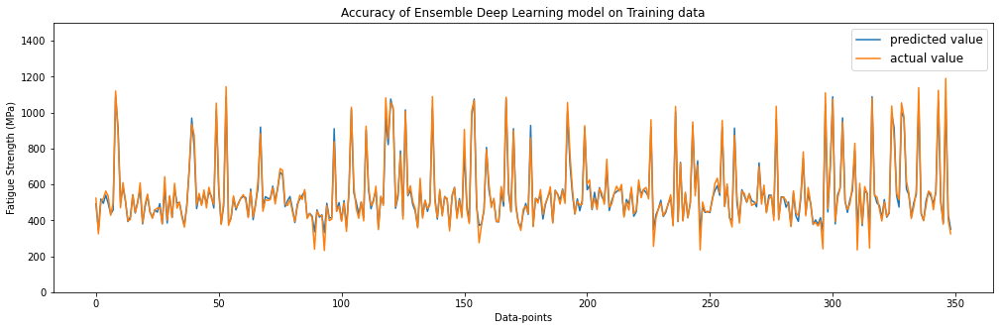

In [148]:
train_pred_10 = (np.ravel(NN_model1.predict(Xtrain)) + np.array(dtregr.predict(Xtrain)) + np.array(xgbregr.predict(Xtrain)) + np.array(lgbmregr.predict(Xtrain)) + np.array(adaregr.predict(Xtrain)))/5
plt.plot(range(349), train_pred_10)
plt.plot(range(349), ytrain)
plt.ylim(0, 1500)
plt.ylabel('Fatigue Strength (MPa)')
plt.xlabel('Data-points')
L = plt.legend('upper right', prop={'size': 12})
L.get_texts()[0].set_text('predicted value')
L.get_texts()[1].set_text('actual value')
fig = plt.gcf()
fig.set_size_inches(17, 5)
plt.title('Accuracy of Ensemble Deep Learning model on Training data')
plt.savefig('EnsembleTrain.png')

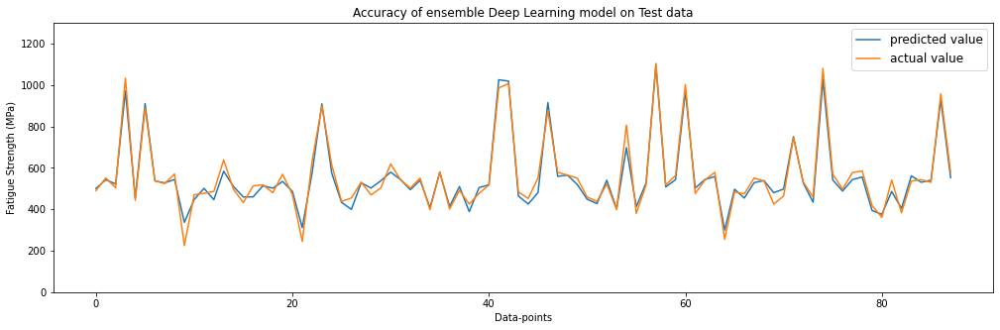

In [149]:
Y_pred_10 = (np.ravel(NN_model1.predict(Xtest)) + np.array(dtregr.predict(Xtest)) + np.array(xgbregr.predict(Xtest)) + np.array(lgbmregr.predict(Xtest)) + np.array(adaregr.predict(Xtest)))/5
plt.plot(range(88), Y_pred_10)
plt.plot(range(88), y_test)
plt.ylim(0, 1300)
plt.ylabel('Fatigue Strength (MPa)')
plt.xlabel('Data-points')
L = plt.legend('upper right', prop={'size': 12})
L.get_texts()[0].set_text('predicted value')
L.get_texts()[1].set_text('actual value')
fig = plt.gcf()
fig.set_size_inches(17, 5)
plt.title('Accuracy of ensemble Deep Learning model on Test data')
plt.savefig('EnsembleTest.png')
plt.show()

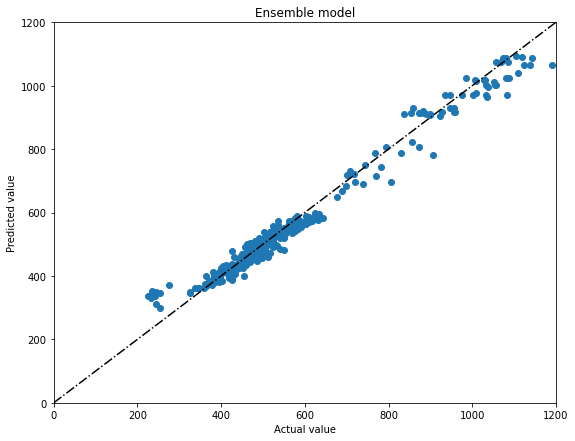

In [150]:
x = np.linspace(0, 1200, 1000)
plt.plot(x, x+0, '-.k')
plt.scatter(y, final_pred)
plt.title("Ensemble model")
plt.xlabel("Actual value")
plt.ylabel("Predicted value")
fig = plt.gcf()
fig.set_size_inches(9, 7)
plt.xlim(0,1200)
plt.ylim(0,1200)
plt.savefig('EnsembleScatter.png')

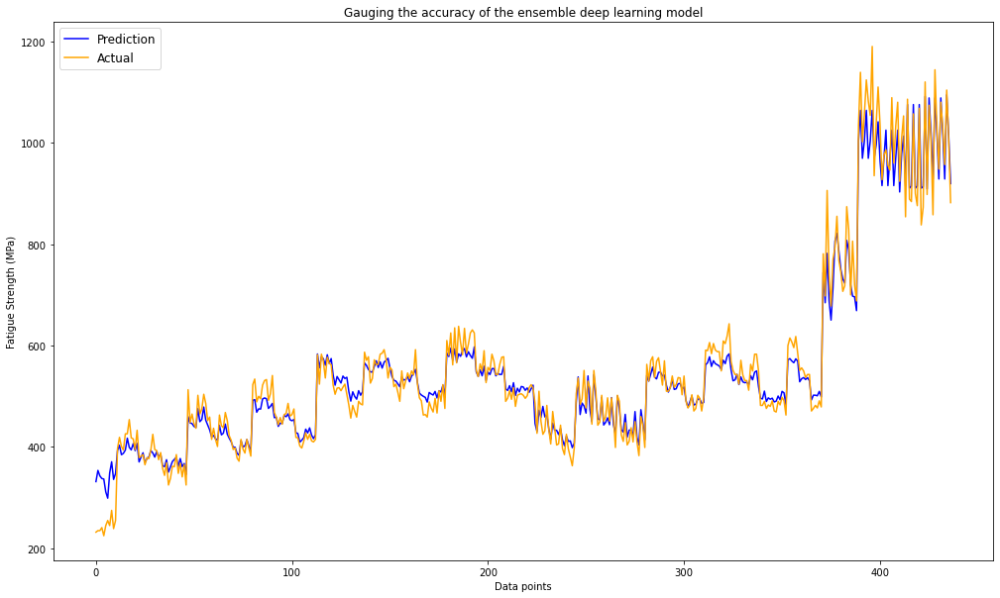

In [151]:
plt.plot(range(437), final_pred, color='Blue', label='Prediction')
plt.plot(range(437), y, color='orange', label='Actual')
plt.title('Gauging the accuracy of the ensemble deep learning model')
plt.legend(loc='upper left', prop={'size': 12})
plt.xlabel('Data points')
plt.ylabel('Fatigue Strength (MPa)')
fig = plt.gcf()
fig.set_size_inches(17, 10)
plt.savefig('EnsemblePred.png')

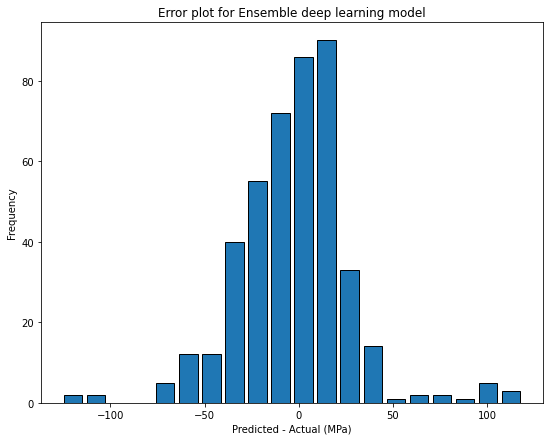

In [152]:
error_9 = final_pred - y
plt.hist(error_9, edgecolor='black', linewidth = 1.0, rwidth = 0.8, bins=20)
plt.title("Error plot for Ensemble deep learning model")
plt.xlabel("Predicted - Actual (MPa)")
plt.ylabel("Frequency")
fig = plt.gcf()
fig.set_size_inches(9, 7)
plt.savefig('EnsembleError.png')

## Summary of different models:

    S. No |  Model                |    Training Data    |    Test Data
    
    1.    |  SVM Regressor        |    0.9648315        |    0.9562091
    2.    |  Linear Regression    |    0.9726291        |    0.9660127
    3.    |  Decision Tree        |    0.9922471        |    0.9665272
    4.    |  ADA Boost Regressor  |    0.9742539        |    0.9745007
    5.    |  Random Forest        |    0.9966556        |    0.9774058
    6.    |  Neural Network       |    0.9884488        |    0.9812295
    7.    |  GB Regressor         |    0.9998022        |    0.9792305
    8.    |  LightGBM Regressor   |    0.9975067        |    0.9847313
    9.    |  XGBoost Regressor    |    0.9986248        |    0.9830212
    10.   |  Ensemble model       |    0.9871900        |    0.9730434

## Feature importance derived from various models:


Features gathered from the observation of a phenomenon are not all equally informative: some of them may be noisy, correlated or irrelevant. Feature selection aims at selecting a feature set that is relevant for a given task.

    S. No |  Model               |  Rank 1  |  Rank 2  |  Rank 3  |  Rank 4  |  Rank 5 
    
    1.    |  Decision Tree       |  Dt      |  Cr      |  C       |  TT      |  NT       
    2.    |  ADA Boost Regressor |  TT      |  Cr      |  Tt      |  Dt      |  Ct
    3.    |  Random Forest       |  QmT     |  Ct      |  Cr      |  NT      |  Tt
    4.    |  LightGBM Regressor  |  TT      |  C       |  Cr      |  P       |  Mn
    5.    |  XGBoost Regressor   |  TT      |  C       |  Cr      |  Mn      |  P